<a href="https://colab.research.google.com/github/anaroberta-cin/mba_analytics/blob/main/Projeto_Analytics_Preditiva.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


**Projeto da Disciplina Analytics Preditiva - MBA Business Analytics - CIN/UFPE**


Desafio: https://www.kaggle.com/competitions/nyc-taxi-trip-duration

Autores: Habacuque Rocha e Ana Roberta



# O DESAFIO
**Criar um modelo de predição do tempo total de duração das corridas de táxi em Nova York.**

A **entrega** deve ser, para cada linha da base de dados de teste, um arquivo contendo as **colunas id e a duração da viagem** no formato a seguir:

id,trip_duration

id00001,978

id00002,978

id00003,978

id00004,978

etc.

A **métrica** a ser usada para avaliação deve ser a **RMSLE**.


# LEITURA E PROCESSAMENTO DA BASE DE DADOS

## Montando Google Drive e importando bibliotecas

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
#%cd /content/gdrive/MyDrive/Analytics Preditiva/PROJETO - Analytics Preditiva/Dados do Kaggle/nyc-taxi-trip-duration
#%cd /content/gdrive/MyDrive/Trabalho Analytics Preditiva/Dados
%cd /content/gdrive/MyDrive/AULAS E CURSOS/MBA BIA/7.AnalyticsPreditiva

!ls

/content/gdrive/MyDrive/AULAS E CURSOS/MBA BIA/7.AnalyticsPreditiva
'Projeto_Analytics_Preditiva (1).ipynb'   tempoNY2016.csv   train.csv
 tempoDiario_NY.csv			  test.csv


In [ ]:
!pip install plotly.express

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Importando bibliotecas 
import os
from datetime import datetime
import numpy as np 
import pandas as pd
import seaborn as sns 
import matplotlib
import matplotlib.pyplot as plt
import missingno as msno
import plotly.graph_objects as go
import sklearn


import plotly.express as px
#from haversine import haversine, Unit

In [ ]:
#instalei pra poder usar o plotyly.express

#!pip install pyyaml==5.4.1

## Subindo *datasets* de treino e teste

In [ ]:
df = pd.read_csv('train.csv') #dataset de treino
df_test = pd.read_csv('test.csv') #dataset de teste

#df = pd.read_csv("/Users/habacuquerocha/Downloads/train.csv")


In [ ]:
#df.head(4)
#df.shape - Habacuque, pensando na apresentação eu sugiro deixar df.info para que a gente consiga explicar o projeto
df.info()
df_test.info()
len(df_test)*100/len(df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 11 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   id                  1458644 non-null  object 
 1   vendor_id           1458644 non-null  int64  
 2   pickup_datetime     1458644 non-null  object 
 3   dropoff_datetime    1458644 non-null  object 
 4   passenger_count     1458644 non-null  int64  
 5   pickup_longitude    1458644 non-null  float64
 6   pickup_latitude     1458644 non-null  float64
 7   dropoff_longitude   1458644 non-null  float64
 8   dropoff_latitude    1458644 non-null  float64
 9   store_and_fwd_flag  1458644 non-null  object 
 10  trip_duration       1458644 non-null  int64  
dtypes: float64(4), int64(3), object(4)
memory usage: 122.4+ MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 625134 entries, 0 to 625133
Data columns (total 9 columns):
 #   Column              Non-Null Count   Dtype  


42.857201620134866

*Temos 1.458.644 entradas e todos os dados estão preenchidos. A quantidade de dados de teste equivalem a 42% da quantidade da base de treinamento.*


In [ ]:
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435


*Ao visualizar os dados disponíveis, percebemos que a duração das viagens está em segundos e julgamos ser melhor visualizar em minutos. Portanto, fizemos a conversão dos dados da coluna.*

## Transformando a duração de segundos para minutos

In [ ]:
df["trip_duration"] = round(df["trip_duration"]/60,4)
#df.head()



## Transformando a coluna store and forward flag para 0(N) e 1(Y)

In [ ]:
df.loc[df.store_and_fwd_flag=="Y","store_and_fwd_flag"]=1
df.loc[df.store_and_fwd_flag=="N","store_and_fwd_flag"]=0

#Replicando para base de teste
df_test.loc[df_test.store_and_fwd_flag=="Y","store_and_fwd_flag"]=1
df_test.loc[df_test.store_and_fwd_flag=="N","store_and_fwd_flag"]=0

In [ ]:
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,0,7.5833
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,0,11.0500
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,0,35.4000
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,0,7.1500
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,0,7.2500


# ALTERAÇÕES NOS DATASETS PARA MELHORAR O MODELO DE PREDIÇÃO

## Incluindo a coluna de distância da viagem (em km)

In [ ]:
#df= df.assign(DISTANCIA = 0.1)

#df["LATITUDE"] = df["pickup_latitude"],df["dropoff_latitude"]
#df["LATITUDE"] = df.loc[:,(df["pickup_latitude"],df["dropoff_latitude"])]
#df= df.assign(LATITUDE = (df["pickup_latitude"],df["dropoff_latitude"]))
#df= df.assign(LONGITUDE = (df["pickup_longitude"],df["dropoff_longitude"]))

#df[["DISTANCIA","pickup_latitude","pickup_longitude","dropoff_latitude","dropoff_longitude"]] = df[["DISTANCIA","pickup_latitude","pickup_longitude","dropoff_latitude","dropoff_longitude"]].astype("float")

#df.head()

#df["DISTANCIA"] = haversine(df["pickup_latitude","pickup_longitude"], df["dropoff_latitude","dropoff_longitude"])

#df["DISTANCIA"] = haversine(df[6:7], df[8:9])

#df["DISTANCIA"] = haversine(df["pickup_longitude"], df["pickup_latitude"], df["dropoff_longitude"], df["dropoff_latitude"])

In [ ]:
def haversine_np(lon_1,lat_1,lon_2,lat_2):

  lon_1,lat_1,lon_2,lat_2 = map(np.radians, [lon_1,lat_1,lon_2,lat_2])	

  dlon = lon_2-lon_1
  dlat = lat_2-lat_1

  a = np.sin(dlat/2.0)**2 + np.cos(lat_1) * np.cos(lat_2) * np.sin(dlon/2.0)**2

  c = 2*np.arcsin(np.sqrt(a))

  km = round(6367*c,4)

  return (km)

In [ ]:
df["distancia"] = haversine_np(df["pickup_longitude"],df["pickup_latitude"],df["dropoff_longitude"],df["dropoff_latitude"])

#Replicando para a base de teste
df_test["distancia"] = haversine_np(df_test["pickup_longitude"],df_test["pickup_latitude"],df_test["dropoff_longitude"],df_test["dropoff_latitude"])
df.head(5)

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,distancia
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,0,7.5833,1.4976
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,0,11.0500,1.8044
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,0,35.4000,6.3811
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,0,7.1500,1.4846
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,0,7.2500,1.1878


## Incluindo colunas para melhor análise da influência da hora e dia



In [ ]:
#df.info()

In [ ]:
#Dicionários utilizados para traduzir dia de inglês para português
dias_ptbr = {'Sunday':'Domingo', 'Monday':'Segunda', 'Tuesday':'Terça', 'Wednesday':'Quarta', 'Thursday':'Quinta', 'Friday':'Sexta', 'Saturday':'Sábado'}
meses_ptbr = {'January':'janeiro', 'February':'fevereiro', 'March':'março', 'April':'abril', 'May':'maio', 'June':'junho', 'July':'julho', 'August':'agosto', 'September':'setembro', 'October':'outubro', 'November':'novembro', 'December':'dezembro'}

#Coluna para contar a quantidade de trajetos(viagens)
df.loc[:,"viagens"] = 1

df_test.loc[:,"viagens"] = 1

#Colunas para hora, mês e dia da semana
df["timestamp_pickup"] = pd.to_datetime(df.pickup_datetime)
df["hora pickup"] = df["timestamp_pickup"].dt.hour
df["mes pickup"] = df["timestamp_pickup"].dt.month_name().replace(meses_ptbr)
df["dia pickup"] = df["timestamp_pickup"].dt.day_name().replace(dias_ptbr)

df_test["timestamp_pickup"] = pd.to_datetime(df_test.pickup_datetime)
df_test["hora pickup"] = df_test["timestamp_pickup"].dt.hour
df_test["mes pickup"] = df_test["timestamp_pickup"].dt.month_name().replace(meses_ptbr)
df_test["dia pickup"] = df_test["timestamp_pickup"].dt.day_name().replace(dias_ptbr)

df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,distancia,viagens,timestamp_pickup,hora pickup,mes pickup,dia pickup
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,0,7.5833,1.4976,1,2016-03-14 17:24:55,17,março,Segunda
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,0,11.0500,1.8044,1,2016-06-12 00:43:35,0,junho,Domingo
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,0,35.4000,6.3811,1,2016-01-19 11:35:24,11,janeiro,Terça
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,0,7.1500,1.4846,1,2016-04-06 19:32:31,19,abril,Quarta
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,0,7.2500,1.1878,1,2016-03-26 13:30:55,13,março,Sábado


In [ ]:
# incluir a coluna para grupamento das horas. Usamos como referência a segmentação utilizada pelos canais de previsão do tempo (https://wgntv.com/weather/how-do-you-define-daytime-and-evening-times-in-a-weather-forecast/)
df.loc[(df["hora pickup"] > 0) & df["hora pickup"] < 6, "periodo"]="Madrugada"
df.loc[(df["hora pickup"] >= 6) & (df["hora pickup"] < 12), "periodo"] = "Manhã"
df.loc[(df["hora pickup"] >= 12) & (df["hora pickup"] < 18), "periodo"] = "Tarde"
df.loc[df["hora pickup"] >= 18, "periodo"] = "Noite"
df.head()

df_test.loc[(df_test["hora pickup"] > 0) & df_test["hora pickup"] < 6, "periodo"]="Madrugada"
df_test.loc[(df_test["hora pickup"] >= 6) & (df_test["hora pickup"] < 12), "periodo"] = "Manhã"
df_test.loc[(df_test["hora pickup"] >= 12) & (df_test["hora pickup"] < 18), "periodo"] = "Tarde"
df_test.loc[df_test["hora pickup"] >= 18, "periodo"] = "Noite"
df_test.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,distancia,viagens,timestamp_pickup,hora pickup,mes pickup,dia pickup,periodo
0,id3004672,1,2016-06-30 23:59:58,1,-73.988129,40.732029,-73.990173,40.756680,0,2.7447,1,2016-06-30 23:59:58,23,junho,Quinta,Noite
1,id3505355,1,2016-06-30 23:59:53,1,-73.964203,40.679993,-73.959808,40.655403,0,2.7575,1,2016-06-30 23:59:53,23,junho,Quinta,Noite
2,id1217141,1,2016-06-30 23:59:47,1,-73.997437,40.737583,-73.986160,40.729523,0,1.3053,1,2016-06-30 23:59:47,23,junho,Quinta,Noite
3,id2150126,2,2016-06-30 23:59:41,1,-73.956070,40.771900,-73.986427,40.730469,0,5.2658,1,2016-06-30 23:59:41,23,junho,Quinta,Noite
4,id1598245,1,2016-06-30 23:59:33,1,-73.970215,40.761475,-73.961510,40.755890,0,0.9602,1,2016-06-30 23:59:33,23,junho,Quinta,Noite


In [ ]:
#df.info()
#df_test.info()

What time is the rush hour in New York?
During weekday rush hours (from 7:30 AM to 9:30 AM and 5 PM to 7 PM, avoid the jammed midtown area, both in the subways and on the streets -- travel time on buses and taxis can easily double. Avenues in Manhattan run north to south and streets run east to west.

Getting Around - The New York Times https://www.nytimes.com › newyorkcity › fdrs_tips_111_2

In [ ]:
# inserindo a hora do rush
import datetime
df.loc[df["dia pickup"] == "Sábado", "rush"] = 0
df.loc[df["dia pickup"] == "Domingo", "rush"] = 0

df_test.loc[df_test["dia pickup"] == "Sábado", "rush"] = 0
df_test.loc[df_test["dia pickup"] == "Domingo", "rush"] = 0

df["timestamp_pickup"].dt.time
df.loc[(df["timestamp_pickup"].dt.time >= datetime.time(7,30,0)) & (df["timestamp_pickup"].dt.time <= datetime.time(9,30,0)), "rush"]= 1
df.loc[(df["timestamp_pickup"].dt.time >= datetime.time(17,00,0)) & (df["timestamp_pickup"].dt.time <= datetime.time(19,00,0)), "rush"]= 1
df.loc[(df["timestamp_pickup"].dt.time > datetime.time(19,00,0)) & (df["timestamp_pickup"].dt.time < datetime.time(23,59,59)), "rush"]= 0
df.loc[(df["timestamp_pickup"].dt.time > datetime.time(0,00,0)) & (df["timestamp_pickup"].dt.time < datetime.time(7,30,0)), "rush"]= 0
df.loc[(df["timestamp_pickup"].dt.time > datetime.time(9,30,0)) & (df["timestamp_pickup"].dt.time < datetime.time(17,00,0)), "rush"]= 0
df["rush"] = df["rush"].astype(bool)
df.head(50)

df_test["timestamp_pickup"].dt.time
df_test.loc[(df_test["timestamp_pickup"].dt.time >= datetime.time(7,30,0)) & (df_test["timestamp_pickup"].dt.time <= datetime.time(9,30,0)), "rush"]= 1
df_test.loc[(df_test["timestamp_pickup"].dt.time >= datetime.time(17,00,0)) & (df_test["timestamp_pickup"].dt.time <= datetime.time(19,00,0)), "rush"]= 1
df_test.loc[(df_test["timestamp_pickup"].dt.time > datetime.time(19,00,0)) & (df_test["timestamp_pickup"].dt.time < datetime.time(23,59,59)), "rush"]= 0
df_test.loc[(df_test["timestamp_pickup"].dt.time > datetime.time(0,00,0)) & (df_test["timestamp_pickup"].dt.time < datetime.time(7,30,0)), "rush"]= 0
df_test.loc[(df_test["timestamp_pickup"].dt.time > datetime.time(9,30,0)) & (df_test["timestamp_pickup"].dt.time < datetime.time(17,00,0)), "rush"]= 0
df_test["rush"] = df_test["rush"].astype(bool)

## Gráficos para análise da quantidade de viagens por hora do dia, período do dia, dia da semana, mês e hora do rush





In [ ]:
df_hora = df.filter(items=["hora pickup","viagens"]).groupby(["hora pickup"]).sum()
fig_hora = px.bar(df_hora, title = "Quantidade de viagens por hora do dia", text_auto=True)
fig_hora.show()

In [ ]:
df_periodo = df.filter(items=["periodo","viagens"]).groupby(["periodo"]).sum()
fig_periodo = px.bar(df_periodo, title = "Quantidade de viagens por período do dia", text_auto=True)
fig_periodo.show()
#como ordenar? Tentei colocar category_orders={"Manhã", "Tarde", "Noite", "Madrugada"}, mas ele não pega nem a pau. 
#Também não consigo mudar o x e o y, vai entender.

In [ ]:
df_diasemana = df.filter(items=["dia pickup","viagens"]).groupby(["dia pickup"]).sum()
fig_diasemana = px.bar(df_diasemana, title = "Quantidade de viagens por dia da semana", text_auto=True)
fig_diasemana.show()
#como ordenar?

In [ ]:
df_mes = df.filter(items=["mes pickup","viagens"]).groupby(["mes pickup"]).sum()
fig_mes = px.bar(df_mes, title = "Quantidade de viagens por mês", text_auto=True)
fig_mes.show()

In [ ]:
df_rush = df.filter(items=["rush","viagens"]).groupby(["rush"]).sum()
fig_rush = px.bar(df_rush, title = "Quantidade de viagens na hora do rush", text_auto=True)
fig_rush.show()

## Incluindo coluna distância/duração, excluindo dados espúrios baseando-se nessa coluna e reordenando as colunas

*Nosso pressuposto para a exclusão de dados expúrios foi de que algumas pessoas pagam o taxista para ficar esperando em um ponto com o taxímetro ligado; então pode acontecer de uma viagem ter uma longa duração comparativamente à distância, mas não necessariamente por problema de trânsito, acidente ou clima. Acreditamos que isso poderia distorcer o modelo.*



In [ ]:
df["distancia/duracao"] = round(df["distancia"]/df["trip_duration"],4)

In [ ]:
dfTeste = df

''' detecção '''
# IQR
Q1 = np.percentile(dfTeste['distancia/duracao'], 25,
                   interpolation = 'midpoint')
 
Q3 = np.percentile(dfTeste['distancia/duracao'], 75,
                   interpolation = 'midpoint')
IQR = Q3 - Q1
 
print("shape antigo: ", dfTeste.shape)
 
# limite superior
upper = np.where(dfTeste['distancia/duracao'] >= (Q3+1.5*IQR))
# limite inferior
lower = np.where(dfTeste['distancia/duracao'] <= (Q1-1.5*IQR))
 
''' removendo os outliers '''
dfTeste = dfTeste.drop(upper[0])
dfTeste = dfTeste.drop(lower[0])
 
print("novo shape: ", dfTeste.shape)



shape antigo:  (1458644, 20)
novo shape:  (1398976, 20)


In [ ]:
df.columns

df = df.reindex(columns=['id', 'vendor_id', 'pickup_datetime', 'dropoff_datetime', 'pickup_longitude', 
                         'pickup_latitude','dropoff_longitude', 'dropoff_latitude', 'timestamp_pickup', 'distancia/duracao',
                         'passenger_count', 'store_and_fwd_flag', 'distancia', 'viagens', 
                         'hora pickup', 'mes pickup', 'dia pickup', 'periodo', 'rush', 'trip_duration'])



In [ ]:
#fig3 = px.box(df, x="distancia/duracao")
#fig3.show()

In [ ]:
#fig4 = px.box(dfTeste, x="distancia/duracao")
#fig4.show()

*Essa distribuição parece fazer bem mais sentido*

(https://g1.globo.com/jornal-nacional/noticia/2014/11/nova-york-reduz-limite-de-velocidade-com-meta-de-zerar-mortes-no-transito.html)

*Vamos usar esse novo dataset para a análise*



In [ ]:
df = dfTeste

In [ ]:
df.shape

(1398976, 20)

# ANÁLISE DESCRITIVA PRELIMINAR

##Usando o Pandas_profilling

In [ ]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
!jupyter nbextension enable --py widgetsnbextension

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 21.8 MB 1.3 MB/s 
     |████████████████████████████████| 596 kB 4.2 MB/s 
     |████████████████████████████████| 102 kB 63.2 MB/s 
     |████████████████████████████████| 690 kB 49.9 MB/s 
     |████████████████████████████████| 4.7 MB 41.6 MB/s 
     |████████████████████████████████| 62 kB 1.6 MB/s 
     |████████████████████████████████| 812 kB 59.5 MB/s 
     |████████████████████████████████| 38.1 MB 49.3 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.2.0-py2.py3-none-any.whl size=262599 sha256=8497622fdf9016cccbcbf5c2570e43072290dca968c39a2ca5758bfa90a7b905
  Stored in directory: /tmp/pip-ephem-wheel-cache-4p6khzew/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=f8157bf3630f12b8ed2517d5eab1bad9b5f7fabc7905a757a0

Enabling notebook extension jupyter-js-widgets/extension...
Paths used for configuration of notebook: 
    	/root/.jupyter/nbconfig/notebook.json
      - Validating: OK
Paths used for configuration of notebook: 
    	/root/.jupyter/nbconfig/notebook.json


In [ ]:
#Pra resolver um erro do pandas_profiling

''' ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.28.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible. '''

'''
!pip uninstall matplotlib
!cd /opt/X11/include/libpng15
!sudo mv png.h _png.h
!sudo mv pngconf.h _pngconf.h
!sudo mv pnglibconf.h _pnglibconf.h
!pip install matplotlib
!sudo mv _png.h png.h
!sudo mv _pngconf.h pngconf.h
!sudo mv _pnglibconf.h pnglibconf.h
'''


In [ ]:
from pandas_profiling import ProfileReport
from pandas_profiling.config import Dataset
from pandas_profiling.utils.cache import cache_file

In [ ]:
profile = ProfileReport(df, title="New York City Taxi Trip", explorative=True)
profile

#antes ele escolhia se rodava ou não. Agora comigo ele não roda nunca...

OSError: ignored


## Verificando se store_and_fwd_flag influencia na duração da viagem

In [ ]:
df_store_and_fwd_flag_positivo = df[df.store_and_fwd_flag=="Y"]
df_store_and_fwd_flag_positivo = df_store_and_fwd_flag_positivo.loc[:,("id","trip_duration")]

#df_store_and_fwd_flag_positivo.head(10)

df_store_and_fwd_flag_negativo = df[df.store_and_fwd_flag=="N"]
df_store_and_fwd_flag_negativo = df_store_and_fwd_flag_negativo.loc[:,("id","trip_duration")]

#df_store_and_fwd_flag_negativo.head(10)

In [ ]:
#df_store_and_fwd_flag_positivo.describe()

Olhando o *violino* das instâncias que possuem store_and_fwd_flag positivo ("Y")

In [ ]:
fig1 = px.violin(df_store_and_fwd_flag_positivo, x="trip_duration", box=True)

fig1.show()


Olhando o violino das instâncias que possuem store_and_fwd_flag negativo ("N")

In [ ]:
fig2 = px.violin(df_store_and_fwd_flag_negativo, x="trip_duration", box=True)
fig2.show()

Comparando os violinos de ambos *datasets* sem os *outliers*:


In [ ]:
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,DISTANCIA,viagens,timestamp_pickup,hora pickup,mes pickup,dia pickup,periodo,rush,DISTANCIA/DURACAO
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,7.583333,1.497580,1,2016-03-14 17:24:55,17,março,Segunda,Tarde,1,0.197483
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,11.050000,1.804374,1,2016-06-12 00:43:35,0,junho,Domingo,Madrugada,0,0.163292
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,35.400000,6.381090,1,2016-01-19 11:35:24,11,janeiro,Terça,Manhã,0,0.180257
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,7.150000,1.484566,1,2016-04-06 19:32:31,19,abril,Quarta,Noite,0,0.207632
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,7.250000,1.187842,1,2016-03-26 13:30:55,13,março,Sábado,Tarde,0,0.163840


In [ ]:

violinoDuplo = go.Figure()

flag = ['Y','N']

for store_and_fwd_flag in flag:
    violinoDuplo.add_trace(go.Violin(y=df['store_and_fwd_flag'][df['store_and_fwd_flag'] == store_and_fwd_flag],
                            x=df['trip_duration'][df['store_and_fwd_flag'] == store_and_fwd_flag],
                            name=store_and_fwd_flag,
                            box_visible=True,
                            orientation="h",
                            meanline_visible=True))

violinoDuplo.show()



Como as escalas são diferentes, por causa dos *outliers*, vamos comparar os violinos de ambos *datasets* sem os *outliers*:

In [ ]:
dfSemOutliers = df.loc[df.trip_duration<=47]

In [ ]:
violinoDuplo2 = go.Figure()

flag = ['Y','N']

for store_and_fwd_flag in flag:
    violinoDuplo2.add_trace(go.Violin(y=dfSemOutliers['store_and_fwd_flag'][dfSemOutliers['store_and_fwd_flag'] == store_and_fwd_flag],
                            x=dfSemOutliers['trip_duration'][dfSemOutliers['store_and_fwd_flag'] == store_and_fwd_flag],
                            name=store_and_fwd_flag,
                            box_visible=True,
                            orientation="h",
                            meanline_visible=True))

violinoDuplo2.show()


Após retirada dos *outliers*, não parece haver diferença substancial entre os tempos de duração de viagens. Parece estar mais relacionada a grande diferença na quantidade de instâncias entre os *datasets*

# AJUSTANDO A BASE PARA RODAR O BASELINE 1 E MODELOS

In [ ]:
df.columns


Index(['id', 'vendor_id', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'trip_duration', 'distancia', 'viagens', 'timestamp_pickup',
       'hora pickup', 'mes pickup', 'dia pickup', 'periodo', 'rush',
       'distancia/duracao'],
      dtype='object')

In [ ]:
#Vamos transformar as categorias das colunas em colunas com resultado 0 ou 1
df_train = pd.get_dummies(df,columns=['dia pickup','mes pickup','periodo'])

#Como acreditamos que a hora influencia na duração da viagem, vamos transformá-la em float
#df_train["data pickup"] = df_train["timestamp_pickup"].dt.date
df_train["timestamp_dropoff"] = pd.to_datetime(df_train.dropoff_datetime)
#df_train["data dropoff"] = df_train["timestamp_dropoff"].dt.date
df_train["hora_num pickup"] = df_train["timestamp_pickup"].dt.hour + round((df_train["timestamp_pickup"].dt.minute/60),4)
df_train["hora_num dropoff"] = df_train["timestamp_dropoff"].dt.hour + round((df_train["timestamp_dropoff"].dt.minute/60),4)
df_train.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,...,mes pickup_junho,mes pickup_maio,mes pickup_março,periodo_Madrugada,periodo_Manhã,periodo_Noite,periodo_Tarde,timestamp_dropoff,hora_num pickup,hora_num dropoff
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,0,...,0,0,1,0,0,0,1,2016-03-14 17:32:30,17.4000,17.5333
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,0,...,1,0,0,1,0,0,0,2016-06-12 00:54:38,0.7167,0.9000
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,0,...,0,0,0,0,1,0,0,2016-01-19 12:10:48,11.5833,12.1667
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,0,...,0,0,0,0,0,1,0,2016-04-06 19:39:40,19.5333,19.6500
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,0,...,0,0,1,0,0,0,1,2016-03-26 13:38:10,13.5000,13.6333


In [ ]:
#Replicando para a base de teste
df_test = pd.get_dummies(df_test,columns=['dia pickup','mes pickup','periodo'])
df_test["hora_num pickup"] = df_test["timestamp_pickup"].dt.hour + round((df_test["timestamp_pickup"].dt.minute/60),4)
df_test.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,distancia,...,mes pickup_fevereiro,mes pickup_janeiro,mes pickup_junho,mes pickup_maio,mes pickup_março,periodo_Madrugada,periodo_Manhã,periodo_Noite,periodo_Tarde,hora_num pickup
0,id3004672,1,2016-06-30 23:59:58,1,-73.988129,40.732029,-73.990173,40.756680,0,2.7447,...,0,0,1,0,0,0,0,1,0,23.9833
1,id3505355,1,2016-06-30 23:59:53,1,-73.964203,40.679993,-73.959808,40.655403,0,2.7575,...,0,0,1,0,0,0,0,1,0,23.9833
2,id1217141,1,2016-06-30 23:59:47,1,-73.997437,40.737583,-73.986160,40.729523,0,1.3053,...,0,0,1,0,0,0,0,1,0,23.9833
3,id2150126,2,2016-06-30 23:59:41,1,-73.956070,40.771900,-73.986427,40.730469,0,5.2658,...,0,0,1,0,0,0,0,1,0,23.9833
4,id1598245,1,2016-06-30 23:59:33,1,-73.970215,40.761475,-73.961510,40.755890,0,0.9602,...,0,0,1,0,0,0,0,1,0,23.9833


In [ ]:
#Como o modelo não comporta as variáveis de data e acreditamos que isso não influencia no modelo, vamos removê-las, bem como a id da viagem 
df_train = df_train.drop(columns=["id","pickup_datetime","dropoff_datetime","timestamp_dropoff","viagens","hora pickup","vendor_id"])
df_train = df_train.drop(columns=["hora_num dropoff","distancia/duracao"]) # estou tirando estas também para testar o df e df test com mesmo tamanho

In [ ]:
#Inserimos a trip_duration no final para facilitar a definição de X e y
last_position = df_train.pop("timestamp_pickup")
df_train.insert(27, "timestamp_pickup", last_position)
df_train.info()

last_position = df_train.pop("trip_duration")
df_train.insert(27, 'trip_duration', last_position)
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1458643
Data columns (total 28 columns):
 #   Column                Non-Null Count    Dtype         
---  ------                --------------    -----         
 0   passenger_count       1398976 non-null  int64         
 1   pickup_longitude      1398976 non-null  float64       
 2   pickup_latitude       1398976 non-null  float64       
 3   dropoff_longitude     1398976 non-null  float64       
 4   dropoff_latitude      1398976 non-null  float64       
 5   store_and_fwd_flag    1398976 non-null  object        
 6   trip_duration         1398976 non-null  float64       
 7   distancia             1398976 non-null  float64       
 8   rush                  1398976 non-null  bool          
 9   dia pickup_Domingo    1398976 non-null  uint8         
 10  dia pickup_Quarta     1398976 non-null  uint8         
 11  dia pickup_Quinta     1398976 non-null  uint8         
 12  dia pickup_Segunda    1398976 non-null  ui

In [ ]:
#Replicando o drop na base de teste 
df_test = df_test.drop(columns=["timestamp_pickup","viagens","hora pickup","vendor_id"])
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 625134 entries, 0 to 625133
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    625134 non-null  object 
 1   pickup_datetime       625134 non-null  object 
 2   passenger_count       625134 non-null  int64  
 3   pickup_longitude      625134 non-null  float64
 4   pickup_latitude       625134 non-null  float64
 5   dropoff_longitude     625134 non-null  float64
 6   dropoff_latitude      625134 non-null  float64
 7   store_and_fwd_flag    625134 non-null  object 
 8   distancia             625134 non-null  float64
 9   rush                  625134 non-null  bool   
 10  dia pickup_Domingo    625134 non-null  uint8  
 11  dia pickup_Quarta     625134 non-null  uint8  
 12  dia pickup_Quinta     625134 non-null  uint8  
 13  dia pickup_Segunda    625134 non-null  uint8  
 14  dia pickup_Sexta      625134 non-null  uint8  
 15  

# RODANDO O BASELINE

## Decidindo o melhor modelo

### testando diferentes regressores:

https://colab.research.google.com/drive/1whIzqba96nFC3vQf8fFZ0rAEt4gx7tCQ#scrollTo=mok7aF_L5RpN



In [ ]:
from matplotlib.colors import ListedColormap
from sklearn.model_selection import cross_val_score

from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor
#from sklearn import neighbors # deu pau
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
#from sklearn.linear_model import Perceptron
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import ExtraTreesRegressor

from sklearn.neighbors import RadiusNeighborsRegressor
#from sklearn.multioutput import MultiOutputRegressor # deu pau
from sklearn.linear_model import SGDRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import PassiveAggressiveRegressor
from sklearn.gaussian_process import GaussianProcessRegressor

from sklearn.model_selection import RepeatedKFold #importando função do sklearn

from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer
from sklearn.metrics import mean_squared_log_error


weight=None
classifiers = {#'Perceptron': Perceptron(class_weight=weight),
             'RandomForestRegressor': RandomForestRegressor(),
             'AdaBoostRegressor': AdaBoostRegressor(),
             'DecisionTreeRegressor': DecisionTreeRegressor(),
#             'neighbors': neighbors(),
#NAN             'GradientBoostingRegressor': GradientBoostingRegressor(),
#NAN             'LinearRegression': LinearRegression(),
             'SVR': SVR(),
             'MLPRegressor': MLPRegressor(),
             'BaggingRegressor': BaggingRegressor(),
#NAN             'RadiusNeighborsRegressor': RadiusNeighborsRegressor(),
#             'MultiOutputRegressor': MultiOutputRegressor(),
#NAN             'SGDRegressor': SGDRegressor(),
#NAN             'Ridge': Ridge(),
#NAN             'GaussianProcessRegressor': GaussianProcessRegressor(),
#NAN              'PassiveAggressiveRegressor': PassiveAggressiveRegressor(),
             'ExtraTreesRegressor': ExtraTreesRegressor()}






In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1458643
Data columns (total 20 columns):
 #   Column              Non-Null Count    Dtype         
---  ------              --------------    -----         
 0   id                  1398976 non-null  object        
 1   vendor_id           1398976 non-null  int64         
 2   pickup_datetime     1398976 non-null  object        
 3   dropoff_datetime    1398976 non-null  object        
 4   passenger_count     1398976 non-null  int64         
 5   pickup_longitude    1398976 non-null  float64       
 6   pickup_latitude     1398976 non-null  float64       
 7   dropoff_longitude   1398976 non-null  float64       
 8   dropoff_latitude    1398976 non-null  float64       
 9   store_and_fwd_flag  1398976 non-null  object        
 10  trip_duration       1398976 non-null  float64       
 11  distancia           1398976 non-null  float64       
 12  viagens             1398976 non-null  int64         
 13  timestamp_pi

In [ ]:
df_testeClass = df_train.sample(frac=0.01)

df_testeClass.fillna(value=0.0)

df_testeClass.head()

X = df_testeClass.iloc[:,10:18]
y = df_testeClass.iloc[:,19]

**Criando o score RMSLE para usar na cross validation**

A raiz do erro médio quadrático e logarítmico (RMSLE, na sigla em inglês) é mais sensível a erros relativos do que erros absolutos e enfoca mais o desempenho insatisfatório do que o desempenho acima do esperado. Vai de -1 a 1.

In [ ]:
from sklearn.metrics import make_scorer
def rmsle(v,v0):
  return np.sqrt(mean_squared_log_error(v,v0))

rmsle_score = make_scorer(rmsle, greater_is_better=False)

In [ ]:
def model_selection(classifiers, X, y, n_splits=10, n_repeats=5):
    models = []
    cv_scores = []
    
    # prepare the cross-validation procedure
    cv = RepeatedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=1)

    # iterate over classifiers
    for name, clf in classifiers.items():
        cv_scores.append(cross_val_score(clf, X, y, cv=cv, scoring=rmsle_score, n_jobs =-1))
        clf.fit(X, y)
        models.append(clf)
    return(models, cv_scores)

In [ ]:
# desempenho com cada base
cv_scores_list = []
cv_models_list = []

model, scores = model_selection(classifiers, X, y)
cv_scores_list.append(scores)
cv_models_list.append(model)

In [ ]:
n_dataset_list = ['df_testeClass'] 

In [ ]:

df_cvs = pd.DataFrame(data=np.array(cv_scores_list).mean(axis=2), 
                       index=n_dataset_list,
                       columns=list(classifiers.keys())).T

In [ ]:
df_cvs.head(10)

,df_testeClass
RandomForestRegressor,-0.233522
AdaBoostRegressor,-0.233619
DecisionTreeRegressor,-0.233531
SVR,-0.256626
MLPRegressor,NaN
BaggingRegressor,-0.233527
ExtraTreesRegressor,-0.233531


In [ ]:
df_cvs = df_cvs.dropna()
df_cvs.head(10)

,df_testeClass
RandomForestRegressor,-0.233522
AdaBoostRegressor,-0.233619
DecisionTreeRegressor,-0.233531
SVR,-0.256626
BaggingRegressor,-0.233527
ExtraTreesRegressor,-0.233531


[Text(1, 0.5, 'SVR'),
 Text(1, 1.5, 'AdaBoostRegressor'),
 Text(1, 2.5, 'RandomForestRegressor'),
 Text(1, 3.5, 'BaggingRegressor'),
 Text(1, 4.5, 'DecisionTreeRegressor'),
 Text(1, 5.5, 'ExtraTreesRegressor')]

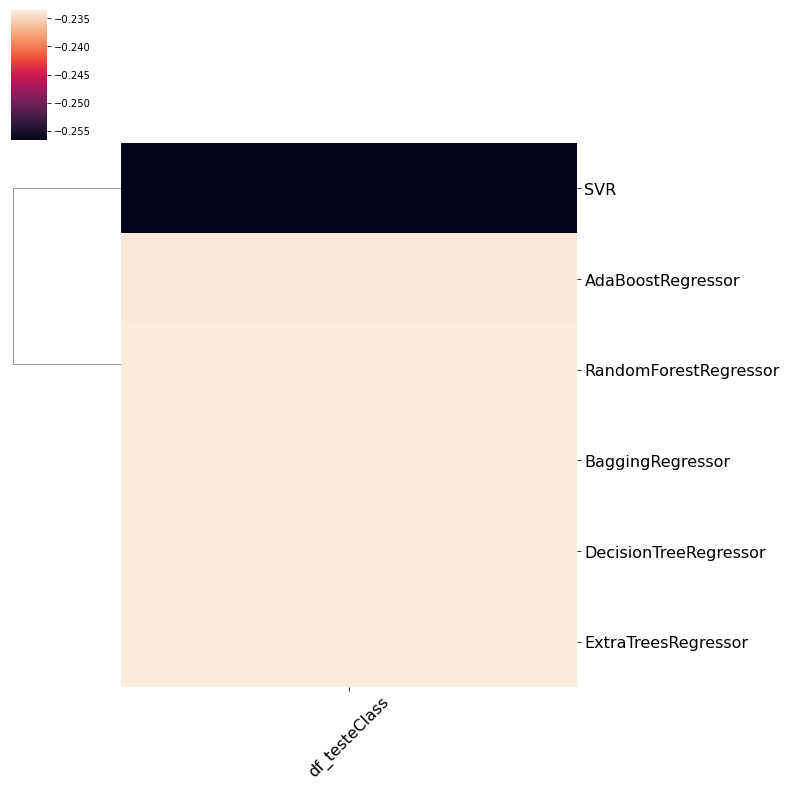

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# plot dos resultados 
g = sns.clustermap(df_cvs,col_cluster=False)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize = 16, rotation=45)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 16)
#plt.savefig('Results_sklearn.png',dpi=600)
#plt.show()

In [ ]:
# criar um dataframe dos resultados
list_metric = []
list_datasets = []
list_models = []
list_cv = []
n_models = len(classifiers)
n_cv = len(cv_scores_list[0])
n_datasets = len(n_dataset_list)
for i in range(n_datasets):
    for j in range(n_models):
      list_metric.extend(cv_scores_list[i][j].tolist())

for i in range(n_datasets):
    list_models.extend([k for k in classifiers.keys() for i in range(n_cv)])

list_datasets = [n_dataset_list[i] for i in range(n_datasets) for j in range(n_models) for k in range(n_cv)]
list_cv = [i for i in range(n_cv)] * n_datasets * n_models

sklearn_list = [list_metric,list_models,list_datasets,list_cv]

df_sklearn = pd.DataFrame (sklearn_list).transpose()
df_sklearn.columns = ['Rmsle','Model','Dataset','Cross Validation']
df_sklearn.head(15)

,Rmsle,Model,Dataset,Cross Validation
0,-0.233749,RandomForestRegressor,df_testeClass,0
1,-0.232318,RandomForestRegressor,df_testeClass,1
2,-0.23864,RandomForestRegressor,df_testeClass,2
3,-0.237396,RandomForestRegressor,df_testeClass,3
4,-0.228003,RandomForestRegressor,df_testeClass,4
5,-0.229243,RandomForestRegressor,df_testeClass,5
6,-0.233611,RandomForestRegressor,df_testeClass,6
7,-0.235423,AdaBoostRegressor,df_testeClass,0
8,-0.231432,AdaBoostRegressor,df_testeClass,1
9,-0.235268,AdaBoostRegressor,df_testeClass,2


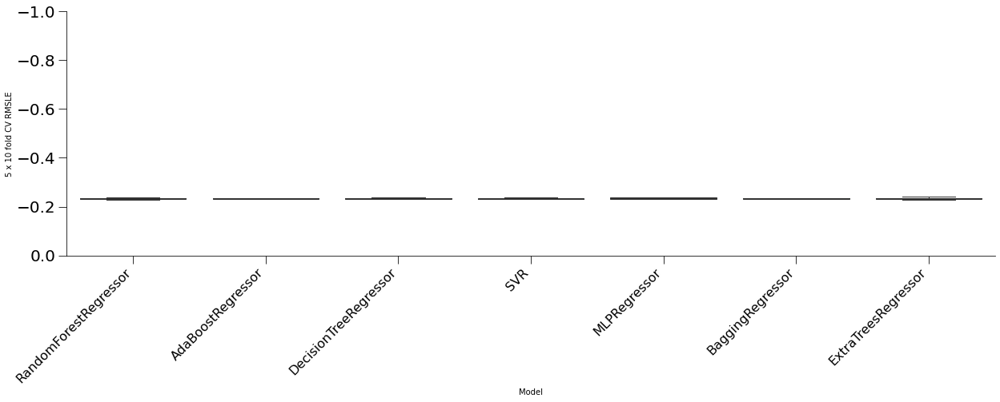

In [ ]:
def stdfigsize(scale=1, nx=1, ny=1, ratio=1.3):
    """
    Returns a tuple to be used as figure size.
    -------
    returns (7*ratio*scale*nx, 7.*scale*ny)
    By default: ratio=1.3
    If ratio<0 them ratio = golden ratio
    """
    if ratio < 0:
        ratio = 1.61803398875
    return((7*ratio*scale*nx, 7*scale*ny))

def custom_frame(ax):
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.get_xaxis().tick_bottom()
    ax.get_yaxis().tick_left()
    ax.tick_params(axis='x',length=10,direction='out')
    ax.tick_params(axis='x',which='minor',direction='out')
    ax.tick_params(axis='y',length=10,direction='out')
    ax.tick_params(axis='y',which='minor',direction='out')

figsize=stdfigsize(ratio=2.5)
xs,ys=figsize

fig,ax = plt.subplots(figsize=(xs,ys))

sns.boxplot(x='Model', y='Rmsle', palette='viridis', linewidth=1, showfliers=False, ax=ax, data=df_sklearn)
plt.xticks(rotation=45,fontsize=16,ha='right')
plt.yticks(fontsize=20)
plt.ylim(0,-1)
ax.set_ylabel('5 x 10 fold CV RMSLE')
plt.tight_layout()
custom_frame(ax)
#plt.savefig('Pattern.png',dpi=600)
#plt.show()

### testando diferentes regressores no df com LAZY PREDICT



In [ ]:
!pip install lazypredict

In [ ]:
import lazypredict
from lazypredict.Supervised import LazyRegressor

from sklearn.model_selection import train_test_split

# carrega os dados
df_lazyPredict = df

df_lazyPredict.loc[df_lazyPredict.store_and_fwd_flag=="Y","store_and_fwd_flag"]=1
df_lazyPredict.loc[df_lazyPredict.store_and_fwd_flag=="N","store_and_fwd_flag"]=0

df_lazyPredict = df_lazyPredict.sample(frac=0.03)

X = df_lazyPredict.iloc[:,4:9]
y = df_lazyPredict.iloc[:,10]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=999)


In [ ]:
reg = LazyRegressor(verbose=0, ignore_warnings=False, custom_metric=None)
models, predictions = reg.fit(X_train, X_test, y_train, y_test)

models

100%|██████████| 42/42 [10:43<00:00, 15.32s/it]


,Adjusted R-Squared,R-Squared,RMSE,Time Taken
Model,,,,
NuSVR,0.03,0.03,46.03,58.81
SVR,0.03,0.03,46.05,54.86
MLPRegressor,0.03,0.03,46.14,23.46
AdaBoostRegressor,0.01,0.01,46.52,0.29
SGDRegressor,0.01,0.01,46.65,0.10
HuberRegressor,0.01,0.01,46.65,0.17
RidgeCV,0.01,0.01,46.65,0.11
Ridge,0.01,0.01,46.65,0.02
Lars,0.01,0.01,46.65,0.12


### testando diferentes regressores no df_train com LAZY PREDICT



In [ ]:
!pip install lazypredict

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
df_train.columns
df_train.info()



In [ ]:
df_lazyPredict

NameError: ignored

In [ ]:
import lazypredict
from lazypredict.Supervised import LazyRegressor

from sklearn.model_selection import train_test_split

from sklearn.metrics import mean_squared_log_error



# carrega os dados
df_lazyPredict = df_train

df_lazyPredict = df_lazyPredict.sample(frac=0.03)

X = df_lazyPredict.iloc[:,0:25]
y = df_lazyPredict.iloc[:,26]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=999)


In [ ]:
reg = LazyRegressor(verbose=0, ignore_warnings=False, custom_metric=mean_squared_log_error)
models, predictions = reg.fit(X_train, X_test, y_train, y_test)

models

  7%|▋         | 3/42 [00:03<00:40,  1.05s/it]

BayesianRidge model failed to execute
Mean Squared Logarithmic Error cannot be used when targets contain negative values.


 17%|█▋        | 7/42 [00:04<00:15,  2.29it/s]

ElasticNetCV model failed to execute
Mean Squared Logarithmic Error cannot be used when targets contain negative values.


 24%|██▍       | 10/42 [02:50<09:04, 17.02s/it]


KeyboardInterrupt: ignored

In [ ]:
resultado_df_train_Lazy = models

resultado_df_train_Lazy.to_csv("resultado_df_train_Lazy.csv",sep=",")


### testando diferentes regressores por autoML:

https://colab.research.google.com/drive/1S9J1VgsmrwadqzyRrCEHCMOXl-Eh7Ua0

##### Importando bibliotecas e montando drive


Por algum bug no Colab, para rodar o auto-sklearn, depois de instalar a linha abaixo precisa reiniciar o runtime: Runtime -> Restart runtime e não instalar novamente (rodar a partir da linha 2)

In [ ]:
#!apt-get install build-essential swig
#!pip3 install auto-sklearn

In [ ]:
import scipy
print(scipy.__version__)
import autosklearn
import sklearn
print(autosklearn.__version__)
import autosklearn.classification

1.7.3
0.14.7


In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive', force_remount=True)

In [ ]:
#%cd /content/gdrive/MyDrive/Analytics Preditiva/PROJETO - Analytics Preditiva/Dados do Kaggle/nyc-taxi-trip-duration
# %cd /content/gdrive/MyDrive/Trabalho Analytics Preditiva/Dados

!ls

acidentes2016.csv  dfExemplo.csv	       sample_submission.csv  test.csv
automl_model	   dfMerge.csv		       tempoDiario_NY.csv     train.csv
dfExemplo2.csv	   dfMerge_taxi_acidentes.csv  tempo_NY.csv


##### Carrega o dataset

In [ ]:
#df.columns

df_automl = df

df_automl.loc[df_automl.store_and_fwd_flag=="Y","store_and_fwd_flag"]=1
df_automl.loc[df_automl.store_and_fwd_flag=="N","store_and_fwd_flag"]=0

df_automl.head()


,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,0,7.5833
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,0,11.0500
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,0,35.4000
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,0,7.1500
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,0,7.2500


In [ ]:
import autosklearn.classification
import sklearn.model_selection
import sklearn.datasets
import sklearn.metrics
import pandas as pd

from pandas import read_csv
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from autosklearn.regression import AutoSklearnRegressor
from autosklearn.metrics import mean_absolute_error as auto_mean_absolute_error
from sklearn.metrics import mean_squared_log_error


X = df_automl.iloc[:,4:9]
y = df_automl.iloc[:,10]

# Separa os dados de treino e teste
X_train, X_test, y_train, y_test = \
        sklearn.model_selection.train_test_split(X, y, random_state=1)


##### Rodar o autosklearn para encontrar o melhor modelo

In [ ]:
automl = AutoSklearnRegressor(time_left_for_this_task=5*60, per_run_time_limit=30, n_jobs=8,seed=88, exclude = {
    'regressor': ["liblinear_svr"]})

df_automl = df_automl.sample(frac=0.01)

automl.fit(X_train, y_train, dataset_name='df_automl')

y_hat = automl.predict(X_test)
print("mean_squared_error", sklearn.metrics.mean_squared_error(y_test, y_hat))
#print("mean_absolute_error", sklearn.metrics.mean_absolute_error(y_test, y_hat))
#print("r2_score", sklearn.metrics.r2_score(y_test, y_hat))
#print("explained_variance_score", sklearn.metrics.explained_variance_score(y_test, y_hat))

#print("rmsle", np.sqrt(mean_squared_log_error(y_test, y_hat))) #não funcionou





mean_squared_error 5972.9836004579465


##### Salvar o modelo treinado

In [ ]:
import pickle
with open('automl_model','wb') as f:
        pickle.dump(automl,f)

##### Carregar o modelo treinado

In [ ]:
import pickle
with open('automl_model', 'rb') as fin:
       load_automl = pickle.load(fin)

##### Testando o novo modelo

In [ ]:
y_hat = load_automl.predict(X_test)
print("mean_squared_error", sklearn.metrics.mean_squared_log_error(y_test, y_hat))

mean_squared_error 0.5500435349995202


##### Visualizando os experimentos

In [ ]:
!pip install PipelineProfiler

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import PipelineProfiler
profiler_data = PipelineProfiler.import_autosklearn(load_automl)
PipelineProfiler.plot_pipeline_matrix(profiler_data)

### testando diferentes regressores no df_train por autoML:

https://colab.research.google.com/drive/1S9J1VgsmrwadqzyRrCEHCMOXl-Eh7Ua0

##### Importando bibliotecas e montando drive


Por algum bug no Colab, para rodar o auto-sklearn, depois de instalar a linha abaixo precisa reiniciar o runtime: Runtime -> Restart runtime e não instalar novamente (rodar a partir da linha 2)

In [ ]:
#!apt-get install build-essential swig
#!pip3 install auto-sklearn

In [ ]:
import scipy
print(scipy.__version__)
import autosklearn
import sklearn
print(autosklearn.__version__)
import autosklearn.classification

1.7.3
0.14.7


In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive', force_remount=True)

In [ ]:
#%cd /content/gdrive/MyDrive/Analytics Preditiva/PROJETO - Analytics Preditiva/Dados do Kaggle/nyc-taxi-trip-duration
# %cd /content/gdrive/MyDrive/Trabalho Analytics Preditiva/Dados

#!ls

##### Carrega o dataset

In [ ]:
#df_automl.info()

In [ ]:
#df.columns

df_automl = df_train
df_automl["store_and_fwd_flag"] = df_automl["store_and_fwd_flag"].astype(int)

#df_automl.head()


In [ ]:
import autosklearn.classification
import sklearn.model_selection
import sklearn.datasets
import sklearn.metrics
import pandas as pd

from pandas import read_csv
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from autosklearn.regression import AutoSklearnRegressor
from autosklearn.metrics import mean_absolute_error as auto_mean_absolute_error
from sklearn.metrics import mean_squared_log_error


X = df_automl.iloc[:,0:25]
y = df_automl.iloc[:,26]

# Separa os dados de treino e teste
X_train, X_test, y_train, y_test = \
        sklearn.model_selection.train_test_split(X, y, random_state=1)


##### Rodar o autosklearn para encontrar o melhor modelo

In [ ]:
#df_automl.info()

In [ ]:
automl = AutoSklearnRegressor(time_left_for_this_task=5*60, per_run_time_limit=30, n_jobs=8,seed=88, exclude = {
    'regressor': ["liblinear_svr"]})

df_automl = df_automl.sample(frac=0.04)

automl.fit(X_train, y_train, dataset_name='df_automl')

y_hat = automl.predict(X_test)
print("mean_squared_error", sklearn.metrics.mean_squared_error(y_test, y_hat))
#print("mean_absolute_error", sklearn.metrics.mean_absolute_error(y_test, y_hat))
#print("r2_score", sklearn.metrics.r2_score(y_test, y_hat))
#print("explained_variance_score", sklearn.metrics.explained_variance_score(y_test, y_hat))

#print("rmsle", np.sqrt(mean_squared_log_error(y_test, y_hat))) #não funcionou





mean_squared_error 6344.473615241967


##### Salvar o modelo treinado

In [ ]:
import pickle
with open('automl_model','wb') as f:
        pickle.dump(automl,f)

##### Carregar o modelo treinado

In [ ]:
import pickle
with open('automl_model', 'rb') as fin:
       load_automl = pickle.load(fin)

##### Testando o novo modelo

In [ ]:
y_hat = load_automl.predict(X_test)
print("mean_squared_log_error", sklearn.metrics.mean_squared_log_error(y_test, y_hat))

mean_squared_log_error 0.5881066858570702


##### Visualizando os experimentos

In [ ]:
!pip install PipelineProfiler

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import PipelineProfiler
profiler_data = PipelineProfiler.import_autosklearn(load_automl)
PipelineProfiler.plot_pipeline_matrix(profiler_data)

# RODANDO OS MODELOS COM A BASE INICIAL (DF_BASE)

*A base inicial é a original somente com o ajuste na duração (de segundos para minutos) e no campo store_and_fwd_flag, de Y/N para 1/0.*
*Escolhemos rodar o Random Forest Regressor e o Extra Trees Regressor para comparar os resultados.*

## Importando as bibliotecas

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_log_error
from sklearn.metrics import r2_score
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer
from numpy import mean
from numpy import std
from pprint import pprint

## Criando o score RMSLE para usar na cross validation

A raiz do erro médio quadrático e logarítmico (RMSLE, na sigla em inglês) é mais sensível a erros relativos do que erros absolutos e enfoca mais o desempenho insatisfatório do que o desempenho acima do esperado. Vai de -1 a 1.

In [ ]:
def rmsle(v,v0):
  return np.sqrt(mean_squared_log_error(v,v0))

rmsle_score = make_scorer(rmsle, greater_is_better=False)

## Gerando as variáveis preditoras e target para a df_base

In [ ]:
df_base = df
df_base.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'trip_duration', 'distancia', 'viagens', 'timestamp_pickup',
       'hora pickup', 'mes pickup', 'dia pickup', 'periodo', 'rush',
       'distancia/duracao'],
      dtype='object')

In [ ]:
#Como o modelo não comporta as variáveis de data e acreditamos que isso não influencia no modelo, vamos removê-las, bem como a id da viagem e do vendor.  
df_base = df_base.drop(columns=['id','pickup_datetime','dropoff_datetime','vendor_id','distancia', 'viagens', 'timestamp_pickup',
       'hora pickup', 'mes pickup', 'dia pickup', 'periodo', 'rush','distancia/duracao'])
df_base.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1458643
Data columns (total 7 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   passenger_count     1398976 non-null  int64  
 1   pickup_longitude    1398976 non-null  float64
 2   pickup_latitude     1398976 non-null  float64
 3   dropoff_longitude   1398976 non-null  float64
 4   dropoff_latitude    1398976 non-null  float64
 5   store_and_fwd_flag  1398976 non-null  object 
 6   trip_duration       1398976 non-null  float64
dtypes: float64(5), int64(1), object(1)
memory usage: 117.6+ MB


In [ ]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 625134 entries, 0 to 625133
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    625134 non-null  object 
 1   pickup_datetime       625134 non-null  object 
 2   passenger_count       625134 non-null  int64  
 3   pickup_longitude      625134 non-null  float64
 4   pickup_latitude       625134 non-null  float64
 5   dropoff_longitude     625134 non-null  float64
 6   dropoff_latitude      625134 non-null  float64
 7   store_and_fwd_flag    625134 non-null  object 
 8   distancia             625134 non-null  float64
 9   rush                  625134 non-null  bool   
 10  dia pickup_Domingo    625134 non-null  uint8  
 11  dia pickup_Quarta     625134 non-null  uint8  
 12  dia pickup_Quinta     625134 non-null  uint8  
 13  dia pickup_Segunda    625134 non-null  uint8  
 14  dia pickup_Sexta      625134 non-null  uint8  
 15  

In [ ]:
#Definindo as variáveis preditoras (X) e a target (y)
X = df_base.iloc[:,0:5]
y = df_base.iloc[:,6]

In [ ]:
#Definindo o intervalo das variáveis da base de teste
X_test = df_test.iloc[:,2:7]

## MODELO RANDOM FOREST REGRESSOR NO DF_BASE

*Para criar a base de dados de treinamento para o modelo random forest regressor, vimos que era necessário não ter colunas categóricas. Também vimos que a timestamp não estava sendo entendida, então segmentamos a informação.*

In [ ]:
X

,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,1,-73.982155,40.767937,-73.964630,40.765602
1,1,-73.980415,40.738564,-73.999481,40.731152
2,1,-73.979027,40.763939,-74.005333,40.710087
3,1,-74.010040,40.719971,-74.012268,40.706718
4,1,-73.973053,40.793209,-73.972923,40.782520
...,...,...,...,...,...
1458637,1,-73.975357,40.751705,-73.949478,40.776764
1458638,5,-73.988823,40.736553,-73.989166,40.757393
1458639,4,-73.982201,40.745522,-73.994911,40.740170
1458642,1,-73.982079,40.749062,-73.974632,40.757107


### Identificando o melhor ajuste de hiperparâmetros

The objective function is modified to accept a trial object. This trial has several methods for sampling hyperparameters. We create a study to run the hyperparameter optimization and finally read the best hyperparameters.

(class) RandomForestRegressor(n_estimators=100, *, criterion="squared_error", max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0, max_features="auto", max_leaf_nodes=None, min_impurity_decrease=0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0, max_samples=None)

In [ ]:
!pip install --quiet optuna

     |████████████████████████████████| 308 kB 35.2 MB/s 
     |████████████████████████████████| 81 kB 10.1 MB/s 
     |████████████████████████████████| 209 kB 80.2 MB/s 
     |████████████████████████████████| 78 kB 7.6 MB/s 
     |████████████████████████████████| 112 kB 82.9 MB/s 
     |████████████████████████████████| 49 kB 6.6 MB/s 
     |████████████████████████████████| 146 kB 90.8 MB/s 


In [ ]:
import optuna

In [ ]:
def objective(trial):
        
    n_estimators = trial.suggest_int('n_estimators', 2, 20)
    max_depth = int(trial.suggest_float('max_depth', 1, 32, log=True))
    
    rf = sklearn.ensemble.RandomForestRegressor(
        n_estimators=n_estimators, max_depth=max_depth)
    
    return sklearn.model_selection.cross_val_score(
        rf, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 17:21:25,889] A new study created in memory with name: no-name-34725341-3064-407d-bd46-e71f9f4aac06
[I 2022-07-01 17:21:34,296] Trial 0 finished with value: -0.7056014265243175 and parameters: {'n_estimators': 8, 'max_depth': 2.600726537801264}. Best is trial 0 with value: -0.7056014265243175.
[I 2022-07-01 17:21:38,835] Trial 1 finished with value: -0.7305069426089988 and parameters: {'n_estimators': 7, 'max_depth': 1.1222404233127303}. Best is trial 0 with value: -0.7056014265243175.
[I 2022-07-01 17:21:50,722] Trial 2 finished with value: -0.6797143208447537 and parameters: {'n_estimators': 6, 'max_depth': 4.629650724205782}. Best is trial 2 with value: -0.6797143208447537.
[I 2022-07-01 17:23:00,399] Trial 3 finished with value: -0.5042572090114925 and parameters: {'n_estimators': 7, 'max_depth': 31.962543785636147}. Best is trial 3 with value: -0.5042572090114925.
[I 2022-07-01 17:23:06,088] Trial 4 finished with value: -0.7316025938363445 and parameters: {'n_estimat

RMSLE: -0.5042572090114925
Best hyperparameters: {'n_estimators': 7, 'max_depth': 31.962543785636147}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

### Rodando o modelo com os hiperparâmetros indicados

In [ ]:
sklearn.metrics.SCORERS.keys()

dict_keys(['explained_variance', 'r2', 'max_error', 'neg_median_absolute_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error', 'neg_mean_squared_error', 'neg_mean_squared_log_error', 'neg_root_mean_squared_error', 'neg_mean_poisson_deviance', 'neg_mean_gamma_deviance', 'accuracy', 'top_k_accuracy', 'roc_auc', 'roc_auc_ovr', 'roc_auc_ovo', 'roc_auc_ovr_weighted', 'roc_auc_ovo_weighted', 'balanced_accuracy', 'average_precision', 'neg_log_loss', 'neg_brier_score', 'adjusted_rand_score', 'rand_score', 'homogeneity_score', 'completeness_score', 'v_measure_score', 'mutual_info_score', 'adjusted_mutual_info_score', 'normalized_mutual_info_score', 'fowlkes_mallows_score', 'precision', 'precision_macro', 'precision_micro', 'precision_samples', 'precision_weighted', 'recall', 'recall_macro', 'recall_micro', 'recall_samples', 'recall_weighted', 'f1', 'f1_macro', 'f1_micro', 'f1_samples', 'f1_weighted', 'jaccard', 'jaccard_macro', 'jaccard_micro', 'jaccard_samples', 'jaccard_wei

In [ ]:
rf = RandomForestRegressor(n_estimators=7,max_depth=31.962543785636147)
rf.fit(X,y)

RandomForestRegressor(max_depth=31.962543785636147, n_estimators=7)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(rf,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

RMSLE: -0.503 (0.001)


In [ ]:
pprint(rf.get_params())

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 31.962543785636147,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 7,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


### Rodando a base de teste para predição

In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'],
      dtype='object')

In [ ]:
df_base.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1458643
Data columns (total 7 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   passenger_count     1398976 non-null  int64  
 1   pickup_longitude    1398976 non-null  float64
 2   pickup_latitude     1398976 non-null  float64
 3   dropoff_longitude   1398976 non-null  float64
 4   dropoff_latitude    1398976 non-null  float64
 5   store_and_fwd_flag  1398976 non-null  object 
 6   trip_duration       1398976 non-null  float64
dtypes: float64(5), int64(1), object(1)
memory usage: 117.6+ MB


In [ ]:
X_test

,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,1,-73.988129,40.732029,-73.990173,40.756680
1,1,-73.964203,40.679993,-73.959808,40.655403
2,1,-73.997437,40.737583,-73.986160,40.729523
3,1,-73.956070,40.771900,-73.986427,40.730469
4,1,-73.970215,40.761475,-73.961510,40.755890
...,...,...,...,...,...
625129,1,-74.003464,40.725105,-74.001251,40.733643
625130,1,-74.006363,40.743782,-73.953407,40.782467
625131,2,-73.972267,40.759865,-73.876602,40.748665
625132,1,-73.976501,40.733562,-73.854263,40.891788


In [ ]:
from sklearn.model_selection import cross_val_predict

prediction = rf.predict(X_test)
prediction

array([16.37133541, 11.99522857,  8.33382697, ..., 36.01647912,
       45.74047143, 28.48332   ])

### Salvando arquivo da predição para submissão

In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'],
      dtype='object')

In [ ]:
rf_para_submissao_dfbase = df_test

rf_para_submissao_dfbase = rf_para_submissao_dfbase.drop(['pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction, columns=['trip_duration'])
rf_para_submissao_dfbase['trip_duration'] = aux['trip_duration']

rf_para_submissao_dfbase.to_csv("rf_para_submissao_dfbase.csv",sep=",")


In [ ]:
rf_para_submissao_dfbase

,id,trip_duration
0,id3004672,16.371335
1,id3505355,11.995229
2,id1217141,8.333827
3,id2150126,16.215545
4,id1598245,7.402642
...,...,...
625129,id3008929,5.142579
625130,id3700764,22.425347
625131,id2568735,36.016479
625132,id1384355,45.740471


## MODELO EXTRA TREES REGRESSOR NO DF_BASE

*Usamos a mesma base de dados e variáveis para este modelo.*

### Identificando o melhor ajuste de hiperparâmetros

The objective function is modified to accept a trial object. This trial has several methods for sampling hyperparameters. We create a study to run the hyperparameter optimization and finally read the best hyperparameters.

(class) RandomForestRegressor(n_estimators=100, *, criterion="squared_error", max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0, max_features="auto", max_leaf_nodes=None, min_impurity_decrease=0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0, max_samples=None)

In [ ]:
!pip install --quiet optuna

     |████████████████████████████████| 308 kB 4.1 MB/s 
     |████████████████████████████████| 209 kB 71.6 MB/s 
     |████████████████████████████████| 81 kB 10.1 MB/s 
     |████████████████████████████████| 78 kB 7.9 MB/s 
     |████████████████████████████████| 49 kB 6.9 MB/s 
     |████████████████████████████████| 112 kB 82.2 MB/s 
     |████████████████████████████████| 146 kB 67.0 MB/s 


In [ ]:
import optuna

In [ ]:
  def objective(trial):

    n_estimators = trial.suggest_int('n_estimators', 2, 30)
    max_depth = int(trial.suggest_float('max_depth', 1, 30, log=True))
    

    etr = sklearn.ensemble.ExtraTreesRegressor(n_estimators=n_estimators, max_depth=max_depth)
    
    return sklearn.model_selection.cross_val_score(
    
      etr, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 17:39:24,584] A new study created in memory with name: no-name-f412dab0-5c6f-4e46-b149-7761068b8388
[I 2022-07-01 17:39:27,101] Trial 0 finished with value: -0.745190833199171 and parameters: {'n_estimators': 5, 'max_depth': 6.8911808406355615}. Best is trial 0 with value: -0.745190833199171.
[I 2022-07-01 17:39:29,001] Trial 1 finished with value: -0.764241284193913 and parameters: {'n_estimators': 9, 'max_depth': 3.3446537735493966}. Best is trial 0 with value: -0.745190833199171.
[I 2022-07-01 17:39:30,986] Trial 2 finished with value: -0.6771954740642497 and parameters: {'n_estimators': 3, 'max_depth': 12.109217330281592}. Best is trial 2 with value: -0.6771954740642497.
[I 2022-07-01 17:39:41,084] Trial 3 finished with value: -0.5334566708536187 and parameters: {'n_estimators': 6, 'max_depth': 27.634480284845583}. Best is trial 3 with value: -0.5334566708536187.
[I 2022-07-01 17:39:41,781] Trial 4 finished with value: -0.7677630587687414 and parameters: {'n_estimator

RMSLE: -0.5334566708536187
Best hyperparameters: {'n_estimators': 6, 'max_depth': 27.634480284845583}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

### Rodando o modelo com os hiperparâmetros indicados

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

etr = ExtraTreesRegressor(n_estimators=6,max_depth=27.634480284845583)
etr.fit(X,y)

ExtraTreesRegressor(max_depth=27.634480284845583, n_estimators=6)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores2 = cross_val_score(etr,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores2), std(n_scores2)))

RMSLE: -0.530 (0.007)


In [ ]:
pprint(etr.get_params())

{'bootstrap': False,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 27.634480284845583,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 6,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


### Rodando a base de teste para predição

In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'],
      dtype='object')

In [ ]:
#df_train.columns

In [ ]:
from sklearn.model_selection import cross_val_predict

prediction2 = etr.predict(X_test)
prediction2

array([13.64337283, 11.41360329,  9.94040484, ..., 25.22500011,
       53.67225   , 24.69913191])

### Salvando arquivo da predição para submissão

In [ ]:
etr_para_submissao_dfbase = df_test

etr_para_submissao_dfbase = etr_para_submissao_dfbase.drop(['pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction2, columns=['trip_duration'])
etr_para_submissao_dfbase['trip_duration'] = aux['trip_duration']

etr_para_submissao_dfbase.to_csv("etr_para_submissao_dfbase.csv",sep=",")

etr_para_submissao_dfbase

,id,trip_duration
0,id3004672,13.643373
1,id3505355,11.413603
2,id1217141,9.940405
3,id2150126,18.453011
4,id1598245,11.002148
...,...,...
625129,id3008929,8.825882
625130,id3700764,24.750957
625131,id2568735,25.225000
625132,id1384355,53.672250


# RODANDO OS MODELOS COM A BASE AUMENTADA (DF_TRAIN)

*Para avaliar se houve evolução no resultado do modelo a partir da criação das novas colunas de informação, rodamos novamente usando a nova base de dados.*


### Gerando as variáveis preditoras e target para o df_train e respectivo df_test

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1458643
Data columns (total 28 columns):
 #   Column                Non-Null Count    Dtype         
---  ------                --------------    -----         
 0   passenger_count       1398976 non-null  int64         
 1   pickup_longitude      1398976 non-null  float64       
 2   pickup_latitude       1398976 non-null  float64       
 3   dropoff_longitude     1398976 non-null  float64       
 4   dropoff_latitude      1398976 non-null  float64       
 5   store_and_fwd_flag    1398976 non-null  object        
 6   distancia             1398976 non-null  float64       
 7   rush                  1398976 non-null  bool          
 8   dia pickup_Domingo    1398976 non-null  uint8         
 9   dia pickup_Quarta     1398976 non-null  uint8         
 10  dia pickup_Quinta     1398976 non-null  uint8         
 11  dia pickup_Segunda    1398976 non-null  uint8         
 12  dia pickup_Sexta      1398976 non-null  ui

In [ ]:
#Definindo as variáveis preditoras (X) e a target (y)
X = df_train.iloc[:,0:25]
y = df_train.iloc[:,27]

In [ ]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 625134 entries, 0 to 625133
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    625134 non-null  object 
 1   pickup_datetime       625134 non-null  object 
 2   passenger_count       625134 non-null  int64  
 3   pickup_longitude      625134 non-null  float64
 4   pickup_latitude       625134 non-null  float64
 5   dropoff_longitude     625134 non-null  float64
 6   dropoff_latitude      625134 non-null  float64
 7   store_and_fwd_flag    625134 non-null  object 
 8   distancia             625134 non-null  float64
 9   rush                  625134 non-null  bool   
 10  dia pickup_Domingo    625134 non-null  uint8  
 11  dia pickup_Quarta     625134 non-null  uint8  
 12  dia pickup_Quinta     625134 non-null  uint8  
 13  dia pickup_Segunda    625134 non-null  uint8  
 14  dia pickup_Sexta      625134 non-null  uint8  
 15  

In [ ]:
#Definindo o intervalo da variável de teste
X_test = df_test.iloc[:,2:27] #não considera a coluna id, mas ela é mantida para poder gerar a tabela final no formato solicitado

## MODELO RANDOM FOREST REGRESSOR NO DF_TRAIN

### Identificando o melhor ajuste de hiperparâmetros

The objective function is modified to accept a trial object. This trial has several methods for sampling hyperparameters. We create a study to run the hyperparameter optimization and finally read the best hyperparameters.

(class) RandomForestRegressor(n_estimators=100, *, criterion="squared_error", max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0, max_features="auto", max_leaf_nodes=None, min_impurity_decrease=0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0, max_samples=None)

In [ ]:
!pip install --quiet optuna

In [ ]:
import optuna

In [ ]:
def objective(trial):
        
    n_estimators = trial.suggest_int('n_estimators', 2, 20)
    max_depth = int(trial.suggest_float('max_depth', 1, 32, log=True))
    
    rf2 = sklearn.ensemble.RandomForestRegressor(
        n_estimators=n_estimators, max_depth=max_depth)
    
    return sklearn.model_selection.cross_val_score(
        rf2, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 17:45:05,388] A new study created in memory with name: no-name-3faf5dfa-0fb0-4a85-858d-6ebea6b09558
[I 2022-07-01 17:46:02,206] Trial 0 finished with value: -0.4894036768915188 and parameters: {'n_estimators': 15, 'max_depth': 5.861275275129895}. Best is trial 0 with value: -0.4894036768915188.
/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py:705: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.

[I 2022-07-01 17:46:24,308] Trial 1 finished with value: -0.5456152750527693 and parameters: {'n_estimators': 13, 'max_depth': 2.912558567651025}. Best is trial 0 with value: -0.4894036768915188.
[I 2022-07-01 17:46:44,697] Trial 2 finished with value: -0.4974194075408012 and parameters: {'n_estimators': 6, 'max_depth': 4.035304803101099}. Best is trial 0 with value: -0.4894036768915188.
[I 2022-07-01 17:47:05,325] Trial 3 finished with value: -0.5491140

RMSLE: -0.4831314144042409
Best hyperparameters: {'n_estimators': 3, 'max_depth': 29.53993910979272}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

### Rodando o modelo com os hiperparâmetros indicados

In [ ]:
sklearn.metrics.SCORERS.keys()

dict_keys(['explained_variance', 'r2', 'max_error', 'neg_median_absolute_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error', 'neg_mean_squared_error', 'neg_mean_squared_log_error', 'neg_root_mean_squared_error', 'neg_mean_poisson_deviance', 'neg_mean_gamma_deviance', 'accuracy', 'top_k_accuracy', 'roc_auc', 'roc_auc_ovr', 'roc_auc_ovo', 'roc_auc_ovr_weighted', 'roc_auc_ovo_weighted', 'balanced_accuracy', 'average_precision', 'neg_log_loss', 'neg_brier_score', 'adjusted_rand_score', 'rand_score', 'homogeneity_score', 'completeness_score', 'v_measure_score', 'mutual_info_score', 'adjusted_mutual_info_score', 'normalized_mutual_info_score', 'fowlkes_mallows_score', 'precision', 'precision_macro', 'precision_micro', 'precision_samples', 'precision_weighted', 'recall', 'recall_macro', 'recall_micro', 'recall_samples', 'recall_weighted', 'f1', 'f1_macro', 'f1_micro', 'f1_samples', 'f1_weighted', 'jaccard', 'jaccard_macro', 'jaccard_micro', 'jaccard_samples', 'jaccard_wei

In [ ]:
rf2 = RandomForestRegressor(n_estimators=3,max_depth=29.53993910979272)
rf2.fit(X,y)

#Best hyperparameters: {'n_estimators': 11, 'max_depth': 4.048095410446627}


RandomForestRegressor(max_depth=29.53993910979272, n_estimators=3)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores3 = cross_val_score(rf2,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores3), std(n_scores3)))

RMSLE: -0.482 (0.002)


In [ ]:
pprint(rf2.get_params())

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 29.53993910979272,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 3,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


### Rodando a base de teste para predição

In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'],
      dtype='object')

In [ ]:
X_test.columns

Index(['pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde'],
      dtype='object')

In [ ]:
print('NaN occurrences in Columns:')
print(X_test.isnull().sum(axis = 0))
print('NaN occurrences in Rows:')
print(X.isnull().sum(axis = 1))

In [ ]:
from sklearn.model_selection import cross_val_predict

prediction3 = rf2.predict(X_test)
prediction3

array([14.08084989, 13.33941705,  6.68931748, ..., 23.93104706,
       54.2222    , 14.4766763 ])

### Salvando arquivo da predição para submissão

In [ ]:
rf_para_submissao_dftrain = df_test

rf_para_submissao_dftrain = rf_para_submissao_dftrain.drop(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction3, columns=['trip_duration'])
rf_para_submissao_dftrain['trip_duration'] = aux['trip_duration']

rf_para_submissao_dftrain.to_csv("rf_para_submissao_dftrain.csv",sep=",")


## MODELO EXTRA TREES REGRESSOR NO DF_TRAIN

### Identificando o melhor ajuste de hiperparâmetros

The objective function is modified to accept a trial object. This trial has several methods for sampling hyperparameters. We create a study to run the hyperparameter optimization and finally read the best hyperparameters.

(class) RandomForestRegressor(n_estimators=100, *, criterion="squared_error", max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0, max_features="auto", max_leaf_nodes=None, min_impurity_decrease=0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0, max_samples=None)

In [ ]:
!pip install --quiet optuna

     |████████████████████████████████| 308 kB 4.1 MB/s 
     |████████████████████████████████| 209 kB 71.6 MB/s 
     |████████████████████████████████| 81 kB 10.1 MB/s 
     |████████████████████████████████| 78 kB 7.9 MB/s 
     |████████████████████████████████| 49 kB 6.9 MB/s 
     |████████████████████████████████| 112 kB 82.2 MB/s 
     |████████████████████████████████| 146 kB 67.0 MB/s 


In [ ]:
import optuna

In [ ]:
  def objective(trial):

    n_estimators = trial.suggest_int('n_estimators', 2, 30)
    max_depth = int(trial.suggest_float('max_depth', 1, 30, log=True))
    

    etr2 = sklearn.ensemble.ExtraTreesRegressor(n_estimators=n_estimators, max_depth=max_depth)
    
    return sklearn.model_selection.cross_val_score(
    
      etr2, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 18:03:10,797] A new study created in memory with name: no-name-359bb221-ab91-4bf4-91f3-1285e810f478
[I 2022-07-01 18:03:20,934] Trial 0 finished with value: -0.748622424667485 and parameters: {'n_estimators': 22, 'max_depth': 1.1531722446115125}. Best is trial 0 with value: -0.748622424667485.
[I 2022-07-01 18:03:37,148] Trial 1 finished with value: -0.5282752457525276 and parameters: {'n_estimators': 5, 'max_depth': 7.586783991832233}. Best is trial 1 with value: -0.5282752457525276.
[I 2022-07-01 18:03:50,212] Trial 2 finished with value: -0.7518588565718156 and parameters: {'n_estimators': 30, 'max_depth': 1.225101789241122}. Best is trial 1 with value: -0.5282752457525276.
[I 2022-07-01 18:04:22,421] Trial 3 finished with value: -0.6795165659181226 and parameters: {'n_estimators': 26, 'max_depth': 3.388237268713951}. Best is trial 1 with value: -0.5282752457525276.
[I 2022-07-01 18:04:34,746] Trial 4 finished with value: -0.7111505013226744 and parameters: {'n_estimat

RMSLE: -0.48617190162667395
Best hyperparameters: {'n_estimators': 17, 'max_depth': 11.16282556984304}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

### Rodando o modelo com os hiperparâmetros indicados

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

etr2 = ExtraTreesRegressor(n_estimators=17,max_depth=11.16282556984304)
etr2.fit(X,y)

#Best hyperparameters: {'n_estimators': 22, 'max_depth': 11.296059935606277}


ExtraTreesRegressor(max_depth=11.16282556984304, n_estimators=17)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores4 = cross_val_score(etr2,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores4), std(n_scores4)))

RMSLE: -0.488 (0.001)


In [ ]:
pprint(etr2.get_params())

{'bootstrap': False,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 11.16282556984304,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 17,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


### Rodando a base de teste para predição

In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'],
      dtype='object')

In [ ]:
#df_train.columns

Index(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup',
       'trip_duration'],
      dtype='object')

In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'],
      dtype='object')

In [ ]:
from sklearn.model_selection import cross_val_predict

prediction4 = etr2.predict(X_test)
prediction4

array([14.75136626, 14.46869166, 10.29577189, ..., 26.05585651,
       72.50873756, 21.46509719])

### Salvando arquivo da predição para submissão

In [ ]:
etr_para_submissao_dftrain = df_test

etr_para_submissao_dftrain = etr_para_submissao_dftrain.drop(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction4, columns=['trip_duration'])
etr_para_submissao_dftrain['trip_duration'] = aux['trip_duration']

etr_para_submissao_dftrain.to_csv("etr_para_submissao_dftrain.csv",sep=",")


# RODANDO OS MODELOS NO DF_TRAIN COM HIPERPARÂMETROS ADICIONAIS E CALIBRADOS

## MODELO RANDOM FOREST REGRESSOR NO DF_TRAIN COM HIPERPARÂMETROS ADICIONAIS

In [ ]:
!pip install --quiet optuna

     |████████████████████████████████| 308 kB 8.0 MB/s 
     |████████████████████████████████| 209 kB 72.2 MB/s 
     |████████████████████████████████| 81 kB 11.6 MB/s 
     |████████████████████████████████| 78 kB 9.2 MB/s 
     |████████████████████████████████| 146 kB 97.5 MB/s 
     |████████████████████████████████| 49 kB 7.5 MB/s 
     |████████████████████████████████| 112 kB 68.8 MB/s 


In [ ]:
import optuna

In [ ]:
def objective(trial):
        
    n_estimators = trial.suggest_int('n_estimators', 2, 20)
    max_depth = int(trial.suggest_float('max_depth', 1, 32, log=True))
    min_samples_split = trial.suggest_int('min_samples_split', 2, 10)
    
    rf3 = sklearn.ensemble.RandomForestRegressor(
        n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split)
    
    return sklearn.model_selection.cross_val_score(
        rf3, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 18:13:54,111] A new study created in memory with name: no-name-27e31f82-aee6-4596-a0ce-5898756a3b8b
[I 2022-07-01 18:17:14,155] Trial 0 finished with value: -0.4957681973628844 and parameters: {'n_estimators': 18, 'max_depth': 17.491872083240246, 'min_samples_split': 6}. Best is trial 0 with value: -0.4957681973628844.
[I 2022-07-01 18:18:17,861] Trial 1 finished with value: -0.4898100315253447 and parameters: {'n_estimators': 17, 'max_depth': 5.944167439070351, 'min_samples_split': 3}. Best is trial 1 with value: -0.4898100315253447.
[I 2022-07-01 18:18:27,979] Trial 2 finished with value: -0.5539313523161039 and parameters: {'n_estimators': 5, 'max_depth': 2.417345515490606, 'min_samples_split': 6}. Best is trial 1 with value: -0.4898100315253447.
[I 2022-07-01 18:20:08,483] Trial 3 finished with value: -0.4969915128638043 and parameters: {'n_estimators': 6, 'max_depth': 31.91461390340193, 'min_samples_split': 6}. Best is trial 1 with value: -0.4898100315253447.
[I 2022

RMSLE: -0.4829009459466405
Best hyperparameters: {'n_estimators': 9, 'max_depth': 8.049846892472996, 'min_samples_split': 6}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

### Rodando o modelo com os hiperparâmetros indicados

In [ ]:
sklearn.metrics.SCORERS.keys()

dict_keys(['explained_variance', 'r2', 'max_error', 'neg_median_absolute_error', 'neg_mean_absolute_error', 'neg_mean_absolute_percentage_error', 'neg_mean_squared_error', 'neg_mean_squared_log_error', 'neg_root_mean_squared_error', 'neg_mean_poisson_deviance', 'neg_mean_gamma_deviance', 'accuracy', 'top_k_accuracy', 'roc_auc', 'roc_auc_ovr', 'roc_auc_ovo', 'roc_auc_ovr_weighted', 'roc_auc_ovo_weighted', 'balanced_accuracy', 'average_precision', 'neg_log_loss', 'neg_brier_score', 'adjusted_rand_score', 'rand_score', 'homogeneity_score', 'completeness_score', 'v_measure_score', 'mutual_info_score', 'adjusted_mutual_info_score', 'normalized_mutual_info_score', 'fowlkes_mallows_score', 'precision', 'precision_macro', 'precision_micro', 'precision_samples', 'precision_weighted', 'recall', 'recall_macro', 'recall_micro', 'recall_samples', 'recall_weighted', 'f1', 'f1_macro', 'f1_micro', 'f1_samples', 'f1_weighted', 'jaccard', 'jaccard_macro', 'jaccard_micro', 'jaccard_samples', 'jaccard_wei

In [ ]:
rf3 = RandomForestRegressor(n_estimators=9,max_depth=8.049846892472996,min_samples_split=6)
rf3.fit(X,y)

#Best hyperparameters: {'n_estimators': 11, 'max_depth': 4.048095410446627}


RandomForestRegressor(max_depth=8.049846892472996, min_samples_split=6,
                      n_estimators=9)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores5 = cross_val_score(rf3,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores5), std(n_scores5)))

RMSLE: -0.481 (0.002)


In [ ]:
pprint(rf3.get_params())

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 8.049846892472996,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 6,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 9,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


### Rodando a base de teste para predição

In [ ]:
df_test.columns

In [ ]:
print('NaN occurrences in Columns:')
print(X_test.isnull().sum(axis = 0))
print('NaN occurrences in Rows:')
print(X.isnull().sum(axis = 1))

In [ ]:
from sklearn.model_selection import cross_val_predict

prediction5 = rf3.predict(X_test)
prediction5

array([15.36979261, 14.78847916,  9.29401554, ..., 28.1080548 ,
       75.89941398, 20.96727283])

### Salvando arquivo da predição para submissão

In [ ]:
rf_para_submissao_dftrain_add = df_test

rf_para_submissao_dftrain_add = rf_para_submissao_dftrain_add.drop(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction5, columns=['trip_duration'])
rf_para_submissao_dftrain_add['trip_duration'] = aux['trip_duration']

rf_para_submissao_dftrain_add.to_csv("rf_para_submissao_dftrain_add.csv",sep=",")


## MODELO EXTRA TREES REGRESSOR NO DF_TRAIN COM HIPERPARÂMETROS ADICIONAIS

In [ ]:
!pip install --quiet optuna

     |████████████████████████████████| 308 kB 4.1 MB/s 
     |████████████████████████████████| 209 kB 71.6 MB/s 
     |████████████████████████████████| 81 kB 10.1 MB/s 
     |████████████████████████████████| 78 kB 7.9 MB/s 
     |████████████████████████████████| 49 kB 6.9 MB/s 
     |████████████████████████████████| 112 kB 82.2 MB/s 
     |████████████████████████████████| 146 kB 67.0 MB/s 


In [ ]:
import optuna

In [ ]:
  def objective(trial):

    n_estimators = trial.suggest_int('n_estimators', 2, 30)
    max_depth = int(trial.suggest_float('max_depth', 1, 30, log=True))
    min_samples_split = trial.suggest_int('min_samples_split', 2, 30)
    

    etr3 = sklearn.ensemble.ExtraTreesRegressor(n_estimators=n_estimators, max_depth=max_depth)
    
    return sklearn.model_selection.cross_val_score(
    
      etr3, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 18:34:48,723] A new study created in memory with name: no-name-c2183b97-8267-4295-9782-208af71b78fc
[I 2022-07-01 18:35:06,112] Trial 0 finished with value: -0.7068535945804385 and parameters: {'n_estimators': 21, 'max_depth': 2.8630009113061776, 'min_samples_split': 24}. Best is trial 0 with value: -0.7068535945804385.
[I 2022-07-01 18:37:23,366] Trial 1 finished with value: -0.5067287268960929 and parameters: {'n_estimators': 19, 'max_depth': 21.22344756546154, 'min_samples_split': 30}. Best is trial 1 with value: -0.5067287268960929.
[I 2022-07-01 18:37:35,873] Trial 2 finished with value: -0.7501933165675586 and parameters: {'n_estimators': 30, 'max_depth': 1.0703099095164421, 'min_samples_split': 18}. Best is trial 1 with value: -0.5067287268960929.
[I 2022-07-01 18:38:20,540] Trial 3 finished with value: -0.6272577927403575 and parameters: {'n_estimators': 28, 'max_depth': 4.5300612758900956, 'min_samples_split': 5}. Best is trial 1 with value: -0.5067287268960929.


RMSLE: -0.4910134348768434
Best hyperparameters: {'n_estimators': 5, 'max_depth': 11.55498211554612, 'min_samples_split': 4}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

### Rodando o modelo com os hiperparâmetros indicados

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

etr3 = ExtraTreesRegressor(n_estimators=5,max_depth=11.55498211554612,min_samples_split=4)
etr3.fit(X,y)

#Best hyperparameters: {'n_estimators': 22, 'max_depth': 11.296059935606277}


ExtraTreesRegressor(max_depth=11.55498211554612, min_samples_split=4,
                    n_estimators=5)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores6 = cross_val_score(etr3,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores6), std(n_scores6)))

RMSLE: -0.488 (0.003)


In [ ]:
pprint(etr3.get_params())

{'bootstrap': False,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 11.55498211554612,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 4,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 5,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


### Rodando a base de teste para predição

In [ ]:
df_test.columns

Index(['id', 'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'],
      dtype='object')

In [ ]:
#df_train.columns

Index(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup',
       'trip_duration'],
      dtype='object')

In [ ]:
df_test.columns

Index(['id', 'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'],
      dtype='object')

In [ ]:
from sklearn.model_selection import cross_val_predict

prediction6 = etr3.predict(X_test)
prediction6

array([15.41734708, 14.78090711,  8.97451142, ..., 26.1293564 ,
       76.67992872, 21.16516367])

### Salvando arquivo da predição para submissão

In [ ]:
etr_para_submissao_dftrain_add = df_test

etr_para_submissao_dftrain_add = etr_para_submissao_dftrain_add.drop(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction6, columns=['trip_duration'])
etr_para_submissao_dftrain_add['trip_duration'] = aux['trip_duration']

etr_para_submissao_dftrain_add.to_csv("etr_para_submissao_dftrain_add.csv",sep=",")


# BUSCA PELA EVOLUÇÃO DO MODELO COM A INCLUSÃO DE DADOS DE CLIMA-TEMPO

## Simplificações do modelo criado:

Para nosso modelo, desconsideramos:
*   Feriados
*   Horário de verão
*   O tempo em outros lugares fora de NY
*   A diferença de clima entre as microestações - tiramos uma média e atribuímos a informação ao dia. Consideramos que um ponto maior de neve ou precipitação pode impactar lugares onde isso não ocorre, por isso optamos pela média.



## upando dataset do clima-tempo em NY de 2016

https://www.ncdc.noaa.gov/cdo-web/search

In [ ]:
#tempo = pd.read_csv('/content/gdrive/MyDrive/Analytics Preditiva/PROJETO - Analytics Preditiva/Dados do tempo-clima em. NY (2016)/tempoNY2016.csv') #drive Habacuque
tempo = pd.read_csv("tempoNY2016.csv")
#tempo = pd.read_csv("/Users/habacuquerocha/Downloads/tempoNY2016.csv")

tempo.head()

,STATION,LATITUDE,LONGITUDE,ELEVATION,DATE,PRCP,SNOW,SNWD,WESD,WT01,WT02,WT03,WT04,WT05,WT06,WT08,WT09,WT11
0,US1NYWC0003,41.0639,-73.7722,71.0,2016-01-01,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,US1NYWC0003,41.0639,-73.7722,71.0,2016-01-02,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,US1NYWC0003,41.0639,-73.7722,71.0,2016-01-03,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,US1NYWC0003,41.0639,-73.7722,71.0,2016-01-04,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,US1NYWC0003,41.0639,-73.7722,71.0,2016-01-05,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
tempo.describe()

,LATITUDE,LONGITUDE,ELEVATION,PRCP,SNOW,SNWD,WESD,WT01,WT02,WT03,WT04,WT05,WT06,WT08,WT09,WT11
count,25780.000000,25780.000000,25596.000000,25391.000000,14387.000000,5457.000000,521.000000,783.0,57.0,135.0,23.0,0.0,15.0,285.0,5.0,5.0
mean,40.753488,-74.059465,43.832318,2.975759,2.466532,15.525930,5.318042,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0
std,0.204226,0.302809,42.972370,7.986899,26.457199,69.432282,15.731163,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0
min,40.275368,-74.482746,0.800000,0.000000,0.000000,0.000000,0.000000,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0
25%,40.658817,-74.282840,12.800000,0.000000,0.000000,0.000000,0.000000,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0
50%,40.752391,-74.147558,24.400000,0.000000,0.000000,0.000000,0.000000,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0
75%,40.902694,-73.881893,66.800000,1.500000,0.000000,0.000000,0.300000,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0
max,41.083546,-73.373090,188.700000,451.100000,770.000000,780.000000,126.700000,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0,1.0


## realizando operações no dataset clima-tempo em NY 2016

In [ ]:
tempoDiario_NY = tempo.drop(columns=['STATION', 'LATITUDE', 'LONGITUDE', 'ELEVATION'])

tempoDiario_NY = tempoDiario_NY.groupby(['DATE']).agg({'mean'}).reset_index()

#tempoDiario_NY.to_csv("tempoDiario_NY.csv",sep=",")

tempo = tempoDiario_NY

#tempoDiario_NY.fillna(value=0.0001)

tempo.head()

,DATE,PRCP,SNOW,SNWD,WESD,WT01,WT02,WT03,WT04,WT05,WT06,WT08,WT09,WT11
,,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
0,2016-01-01,0.040625,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2016-01-02,0.004839,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2016-01-03,0.000000,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
3,2016-01-04,0.000000,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2016-01-05,0.000000,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##  realizando merge dos datasets (taxi + tempo)

1. como o merge não tá rolando com o dataset completo, vou fazer os testes com um dataset menor (precisamos ajustar isso depois) 😓

2. o merge tá duplicando linhas =/

In [ ]:
df_exemplo = df_train
df_exemplo.shape

(1398976, 29)

In [ ]:
df_exemplo["DIA"] = df["pickup_datetime"]
df_exemplo["DIA"] = pd.to_datetime(df_exemplo['DIA'])

tempo["DIA"] = tempo["DATE"]
tempo["DIA"] = pd.to_datetime(tempo["DIA"])

df_exemplo["DIA"] = df_exemplo["DIA"].dt.strftime('%Y-%m-%d')
tempo["DIA"] = tempo["DIA"].dt.strftime('%Y-%m-%d')

In [ ]:
tempo.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 366 entries, 0 to 365
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   (DATE, )      366 non-null    object 
 1   (PRCP, mean)  366 non-null    float64
 2   (SNOW, mean)  366 non-null    float64
 3   (SNWD, mean)  366 non-null    float64
 4   (WESD, mean)  210 non-null    float64
 5   (WT01, mean)  205 non-null    float64
 6   (WT02, mean)  32 non-null     float64
 7   (WT03, mean)  53 non-null     float64
 8   (WT04, mean)  16 non-null     float64
 9   (WT05, mean)  0 non-null      float64
 10  (WT06, mean)  7 non-null      float64
 11  (WT08, mean)  156 non-null    float64
 12  (WT09, mean)  2 non-null      float64
 13  (WT11, mean)  5 non-null      float64
 14  (DIA, )       366 non-null    object 
dtypes: float64(13), object(2)
memory usage: 43.0+ KB


In [ ]:
#dfExemplo.shape
#dfExemplo.head()
#tempo.head()
tempo.isna().sum()
#tempo.shape
#tempo.columns

DATE            0
PRCP  mean      0
SNOW  mean      0
SNWD  mean      0
WESD  mean    156
WT01  mean    161
WT02  mean    334
WT03  mean    313
WT04  mean    350
WT05  mean    366
WT06  mean    359
WT08  mean    210
WT09  mean    364
WT11  mean    361
DIA             0
dtype: int64

In [ ]:
tempo = tempo.drop([('DATE',''),
            ('WT02', 'mean'),
            ('WT03', 'mean'),
            ('WT04', 'mean'),
            ('WT05', 'mean'),
            ('WT06', 'mean'),
            ('WT08', 'mean'),
            ('WT09', 'mean'),
            ('WT11', 'mean')], axis=1)

In [ ]:
df_merge = pd.merge(df_exemplo,tempo,how='left', on=["DIA"])

df_merge = df_merge.fillna(value=0.0001)

df_merge = df_merge.round({'passenger_count':4,'pickup_longitude':4,
                         'pickup_latitude':4,'dropoff_longitude':4,'dropoff_latitude':4, 'store_and_fwd_flag':4,'trip_duration':4,
                         'distancia':4, 'viagens':4,'hora pickup':4,'distancia/duracao':4,('PRCP', 'mean'):4,('SNOW', 'mean'):4, ('SNWD', 'mean'):4,
                         ('WESD', 'mean'):4,('WT01', 'mean'):4})

df_merge.head()

#df_merge.shape
#df_merge.columns

#df_merge.to_csv("dfMerge.csv",sep=",")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning:

merging between different levels is deprecated and will be removed in a future version. (1 levels on the left,2 on the right)



,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,distancia,rush,dia pickup_Domingo,dia pickup_Quarta,...,periodo_Tarde,hora_num pickup,timestamp_pickup,trip_duration,DIA,"(PRCP, mean)","(SNOW, mean)","(SNWD, mean)","(WESD, mean)","(WT01, mean)"
0,1,-73.9822,40.7679,-73.9646,40.7656,0,1.4976,True,0,0,...,1,17.4000,2016-03-14 17:24:55,7.5833,2016-03-14,3.5562,0.0000,0.0,0.00,1.0000
1,1,-73.9804,40.7386,-73.9995,40.7312,0,1.8044,False,1,0,...,0,0.7167,2016-06-12 00:43:35,11.0500,2016-06-12,0.3237,0.0000,0.0,0.00,0.0001
2,1,-73.9790,40.7639,-74.0053,40.7101,0,6.3811,False,0,0,...,0,11.5833,2016-01-19 11:35:24,35.4000,2016-01-19,0.0129,0.2453,5.0,0.06,0.0001
3,1,-74.0100,40.7200,-74.0123,40.7067,0,1.4846,False,0,1,...,0,19.5333,2016-04-06 19:32:31,7.1500,2016-04-06,0.0000,0.0000,0.0,0.00,0.0001
4,1,-73.9731,40.7932,-73.9729,40.7825,0,1.1878,False,0,0,...,1,13.5000,2016-03-26 13:30:55,7.2500,2016-03-26,0.9169,0.0000,0.0,0.00,1.0000


In [ ]:
df_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1398975
Data columns (total 34 columns):
 #   Column                Non-Null Count    Dtype         
---  ------                --------------    -----         
 0   passenger_count       1398976 non-null  int64         
 1   pickup_longitude      1398976 non-null  float64       
 2   pickup_latitude       1398976 non-null  float64       
 3   dropoff_longitude     1398976 non-null  float64       
 4   dropoff_latitude      1398976 non-null  float64       
 5   store_and_fwd_flag    1398976 non-null  int64         
 6   distancia             1398976 non-null  float64       
 7   rush                  1398976 non-null  bool          
 8   dia pickup_Domingo    1398976 non-null  uint8         
 9   dia pickup_Quarta     1398976 non-null  uint8         
 10  dia pickup_Quinta     1398976 non-null  uint8         
 11  dia pickup_Segunda    1398976 non-null  uint8         
 12  dia pickup_Sexta      1398976 non-null  ui

In [ ]:
#Inserindo a trip_duration no final para facilitar a definição de X e y
last_position = df_merge.pop("DIA")
df_merge.insert(33, 'DIA', last_position)

last_position = df_merge.pop("timestamp_pickup")
df_merge.insert(33, 'timestamp_pickup', last_position)

last_position = df_merge.pop("trip_duration")
df_merge.insert(33, 'trip_duration', last_position)
df_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1398975
Data columns (total 34 columns):
 #   Column                Non-Null Count    Dtype         
---  ------                --------------    -----         
 0   passenger_count       1398976 non-null  int64         
 1   pickup_longitude      1398976 non-null  float64       
 2   pickup_latitude       1398976 non-null  float64       
 3   dropoff_longitude     1398976 non-null  float64       
 4   dropoff_latitude      1398976 non-null  float64       
 5   store_and_fwd_flag    1398976 non-null  int64         
 6   distancia             1398976 non-null  float64       
 7   rush                  1398976 non-null  bool          
 8   dia pickup_Domingo    1398976 non-null  uint8         
 9   dia pickup_Quarta     1398976 non-null  uint8         
 10  dia pickup_Quinta     1398976 non-null  uint8         
 11  dia pickup_Segunda    1398976 non-null  uint8         
 12  dia pickup_Sexta      1398976 non-null  ui

replicando para o DF_teste


In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup', 'DIA'],
      dtype='object')

In [ ]:
df_exemplo_test = df_test
df_exemplo_test["DIA"] = df_test["pickup_datetime"] #a gente removeu pickup datetime (vê as colunas no código logo acima), de onde resgatar?
df_exemplo_test["DIA"] = pd.to_datetime(df_exemplo_test['DIA'])

df_exemplo_test["DIA"] = df_exemplo_test["DIA"].dt.strftime('%Y-%m-%d')

In [ ]:
df_test_merge = pd.merge(df_exemplo_test,tempo,how='left', on=["DIA"])

df_test_merge = df_test_merge.fillna(value=0.0001)

df_test_merge = df_test_merge.round({'passenger_count':4,'pickup_longitude':4,
                         'pickup_latitude':4,'dropoff_longitude':4,'dropoff_latitude':4, 'store_and_fwd_flag':4,'trip_duration':4,
                         'distancia':4, 'viagens':4,'hora pickup':4,'distancia/duracao':4,('PRCP', 'mean'):4,('SNOW', 'mean'):4, ('SNWD', 'mean'):4,
                         ('WESD', 'mean'):4,('WT01', 'mean'):4})

df_test_merge.head()

#df_merge.shape
#df_merge.columns

#df_merge.to_csv("dfMerge.csv",sep=",")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning:

merging between different levels is deprecated and will be removed in a future version. (1 levels on the left,2 on the right)



,id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,distancia,rush,...,periodo_Manhã,periodo_Noite,periodo_Tarde,hora_num pickup,DIA,"(PRCP, mean)","(SNOW, mean)","(SNWD, mean)","(WESD, mean)","(WT01, mean)"
0,id3004672,2016-06-30 23:59:58,1,-73.9881,40.7320,-73.9902,40.7567,0,2.7447,False,...,0,1,0,23.9833,2016-06-30,0.0054,0.0,0.0,0.0001,0.0001
1,id3505355,2016-06-30 23:59:53,1,-73.9642,40.6800,-73.9598,40.6554,0,2.7575,False,...,0,1,0,23.9833,2016-06-30,0.0054,0.0,0.0,0.0001,0.0001
2,id1217141,2016-06-30 23:59:47,1,-73.9974,40.7376,-73.9862,40.7295,0,1.3053,False,...,0,1,0,23.9833,2016-06-30,0.0054,0.0,0.0,0.0001,0.0001
3,id2150126,2016-06-30 23:59:41,1,-73.9561,40.7719,-73.9864,40.7305,0,5.2658,False,...,0,1,0,23.9833,2016-06-30,0.0054,0.0,0.0,0.0001,0.0001
4,id1598245,2016-06-30 23:59:33,1,-73.9702,40.7615,-73.9615,40.7559,0,0.9602,False,...,0,1,0,23.9833,2016-06-30,0.0054,0.0,0.0,0.0001,0.0001


In [ ]:
#df_merge.shape
#df_merge.isna().mean()
#df_merge.isna().sum()

df_test_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 625134 entries, 0 to 625133
Data columns (total 34 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    625134 non-null  object 
 1   pickup_datetime       625134 non-null  object 
 2   passenger_count       625134 non-null  int64  
 3   pickup_longitude      625134 non-null  float64
 4   pickup_latitude       625134 non-null  float64
 5   dropoff_longitude     625134 non-null  float64
 6   dropoff_latitude      625134 non-null  float64
 7   store_and_fwd_flag    625134 non-null  int64  
 8   distancia             625134 non-null  float64
 9   rush                  625134 non-null  bool   
 10  dia pickup_Domingo    625134 non-null  uint8  
 11  dia pickup_Quarta     625134 non-null  uint8  
 12  dia pickup_Quinta     625134 non-null  uint8  
 13  dia pickup_Segunda    625134 non-null  uint8  
 14  dia pickup_Sexta      625134 non-null  uint8  
 15  

In [ ]:
df_test_merge.info()

In [ ]:
#Replicando a alteração de DIA para o final da base de teste
last_position = df_test_merge.pop("DIA")
df_test_merge.insert(33, 'DIA', last_position)
df_test_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 625134 entries, 0 to 625133
Data columns (total 34 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    625134 non-null  object 
 1   pickup_datetime       625134 non-null  object 
 2   passenger_count       625134 non-null  int64  
 3   pickup_longitude      625134 non-null  float64
 4   pickup_latitude       625134 non-null  float64
 5   dropoff_longitude     625134 non-null  float64
 6   dropoff_latitude      625134 non-null  float64
 7   store_and_fwd_flag    625134 non-null  int64  
 8   distancia             625134 non-null  float64
 9   rush                  625134 non-null  bool   
 10  dia pickup_Domingo    625134 non-null  uint8  
 11  dia pickup_Quarta     625134 non-null  uint8  
 12  dia pickup_Quinta     625134 non-null  uint8  
 13  dia pickup_Segunda    625134 non-null  uint8  
 14  dia pickup_Sexta      625134 non-null  uint8  
 15  

## Gerando as variáveis preditoras e target para o df_merge e respectivo df_merge_test

In [ ]:
df_merge.columns
df_merge.info()

In [ ]:
df_test_merge.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 625134 entries, 0 to 625133
Data columns (total 34 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    625134 non-null  object 
 1   pickup_datetime       625134 non-null  object 
 2   passenger_count       625134 non-null  int64  
 3   pickup_longitude      625134 non-null  float64
 4   pickup_latitude       625134 non-null  float64
 5   dropoff_longitude     625134 non-null  float64
 6   dropoff_latitude      625134 non-null  float64
 7   store_and_fwd_flag    625134 non-null  int64  
 8   distancia             625134 non-null  float64
 9   rush                  625134 non-null  bool   
 10  dia pickup_Domingo    625134 non-null  uint8  
 11  dia pickup_Quarta     625134 non-null  uint8  
 12  dia pickup_Quinta     625134 non-null  uint8  
 13  dia pickup_Segunda    625134 non-null  uint8  
 14  dia pickup_Sexta      625134 non-null  uint8  
 15  

In [ ]:
#Replicando o drop na base de teste 
#df_test = df_test.drop(columns=["pickup_datetime","timestamp_pickup","viagens","hora pickup","vendor_id"])
#df_test.info()

In [ ]:
#Definindo as variáveis preditoras (X) e a target (y)
X = df_merge.iloc[:,0:30]
y = df_merge.iloc[:,33]

In [ ]:
X_test = df_test_merge.iloc[:,2:32] #não considera a coluna id, mas ela é mantida para poder gerar a tabela final no formato solicitado

## Simplificações do modelo criado:

Para nosso modelo, desconsideramos:
*   Feriados
*   Horário de verão
*   O tempo em outros lugares fo ra de NY
*   A diferença de clima entre as microestações - tiramos uma média e atribuímos a informação ao dia. Consideramos que um ponto maior de neve ou precipitação pode impactar lugares onde isso não ocorre, por isso optamos pela média.



## MODELO RANDOM FOREST REGRESSOR NO DF_MERGE (2 hiperparâmetros)

### Identificando o melhor ajuste de hiperparâmetros

In [ ]:
def objective(trial):
        
    n_estimators = trial.suggest_int('n_estimators', 2, 20)
    max_depth = int(trial.suggest_float('max_depth', 1, 32, log=True))
    
    rf4 = sklearn.ensemble.RandomForestRegressor(
        n_estimators=n_estimators, max_depth=max_depth)
    
    return sklearn.model_selection.cross_val_score(
        rf4, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 20:06:06,451] A new study created in memory with name: no-name-862eb6e2-b3be-4e64-b343-0ce856768560
[I 2022-07-01 20:06:37,122] Trial 0 finished with value: -0.4751038145683319 and parameters: {'n_estimators': 4, 'max_depth': 9.390350811345376}. Best is trial 0 with value: -0.4751038145683319.
[I 2022-07-01 20:09:09,902] Trial 1 finished with value: -0.49759304076784633 and parameters: {'n_estimators': 12, 'max_depth': 18.53922011672571}. Best is trial 0 with value: -0.4751038145683319.
[I 2022-07-01 20:10:00,243] Trial 2 finished with value: -0.5046386845168694 and parameters: {'n_estimators': 20, 'max_depth': 3.704994440863725}. Best is trial 0 with value: -0.4751038145683319.
[I 2022-07-01 20:10:52,233] Trial 3 finished with value: -0.4934457853839022 and parameters: {'n_estimators': 16, 'max_depth': 4.70477684633314}. Best is trial 0 with value: -0.4751038145683319.
[I 2022-07-01 20:11:57,525] Trial 4 finished with value: -0.48053999930090957 and parameters: {'n_estim

RMSLE: -0.473618259181617
Best hyperparameters: {'n_estimators': 17, 'max_depth': 9.741913396418894}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

### Rodando o modelo com os hiperparâmetros indicados

In [ ]:
rf4 = RandomForestRegressor(n_estimators=17,max_depth=9.741913396418894)
rf4.fit(X,y)

#Best hyperparameters: {'n_estimators': 11, 'max_depth': 4.048095410446627}


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1692: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['str', 'tuple']. An error will be raised in 1.2.



RandomForestRegressor(max_depth=9.741913396418894, n_estimators=17)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores7 = cross_val_score(rf4,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores7), std(n_scores7)))

RMSLE: -0.473 (0.001)


In [ ]:
pprint(rf4.get_params())

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 9.741913396418894,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 17,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


### Rodando a base de teste para predição

In [ ]:
df_test.columns

Index(['id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde',
       'hora_num pickup'],
      dtype='object')

In [ ]:
X_test.columns

Index(['pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'distancia', 'rush', 'dia pickup_Domingo',
       'dia pickup_Quarta', 'dia pickup_Quinta', 'dia pickup_Segunda',
       'dia pickup_Sexta', 'dia pickup_Sábado', 'dia pickup_Terça',
       'mes pickup_abril', 'mes pickup_fevereiro', 'mes pickup_janeiro',
       'mes pickup_junho', 'mes pickup_maio', 'mes pickup_março',
       'periodo_Madrugada', 'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde'],
      dtype='object')

In [ ]:
from sklearn.model_selection import cross_val_predict

prediction7 = rf4.predict(X_test)
prediction7

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1692: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['str', 'tuple']. An error will be raised in 1.2.



array([  14.88694024,   14.18845685,    9.53327434, ...,   26.24416916,
       1963.45088729,   23.70461233])

### Salvando arquivo da predição para submissão

In [ ]:
rf_para_submissao_dfmerge = df_test

rf_para_submissao_dfmerge = rf_para_submissao_dfmerge.drop(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction7, columns=['trip_duration'])
rf_para_submissao_dfmerge['trip_duration'] = aux['trip_duration']

rf_para_submissao_dfmerge.to_csv("rf_para_submissao_dfmerge.csv",sep=",")


# MODELO EXTRA TREES REGRESSOR NO DF_MERGE (2 hiperparâmetros)

*Para criar a base de dados de treinamento para o modelo random fores regressor, vimos que era necessário não ter colunas categóricas. Também vimos que a timestamp não estava sendo entendida, então segmentamos a informação.*

## Identificando o melhor ajuste de hiperparâmetros

The objective function is modified to accept a trial object. This trial has several methods for sampling hyperparameters. We create a study to run the hyperparameter optimization and finally read the best hyperparameters.

(class) RandomForestRegressor(n_estimators=100, *, criterion="squared_error", max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0, max_features="auto", max_leaf_nodes=None, min_impurity_decrease=0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0, max_samples=None)

In [ ]:
!pip install --quiet optuna

     |████████████████████████████████| 308 kB 4.1 MB/s 
     |████████████████████████████████| 209 kB 71.6 MB/s 
     |████████████████████████████████| 81 kB 10.1 MB/s 
     |████████████████████████████████| 78 kB 7.9 MB/s 
     |████████████████████████████████| 49 kB 6.9 MB/s 
     |████████████████████████████████| 112 kB 82.2 MB/s 
     |████████████████████████████████| 146 kB 67.0 MB/s 


In [ ]:
import optuna

In [ ]:
  def objective(trial):

    n_estimators = trial.suggest_int('n_estimators', 2, 30)
    max_depth = int(trial.suggest_float('max_depth', 1, 30, log=True))
    

    etr4 = sklearn.ensemble.ExtraTreesRegressor(n_estimators=n_estimators, max_depth=max_depth)
    
    return sklearn.model_selection.cross_val_score(
    
      etr4, X, y, n_jobs=-1, cv=3, scoring=rmsle_score).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

trial = study.best_trial

print('RMSLE: {}'.format(trial.value))
print("Best hyperparameters: {}".format(trial.params))

[I 2022-07-01 19:38:18,801] A new study created in memory with name: no-name-b1e7413c-5797-4dce-8938-73e46060ab36
[I 2022-07-01 19:39:38,001] Trial 0 finished with value: -0.48442804619930585 and parameters: {'n_estimators': 11, 'max_depth': 15.705364978745676}. Best is trial 0 with value: -0.48442804619930585.
[I 2022-07-01 19:43:07,456] Trial 1 finished with value: -0.48247665149014535 and parameters: {'n_estimators': 30, 'max_depth': 14.494824616133863}. Best is trial 1 with value: -0.48247665149014535.
[I 2022-07-01 19:45:58,468] Trial 2 finished with value: -0.4842935880950677 and parameters: {'n_estimators': 25, 'max_depth': 15.844768224154059}. Best is trial 1 with value: -0.48247665149014535.
[I 2022-07-01 19:47:14,897] Trial 3 finished with value: -0.5122229618311155 and parameters: {'n_estimators': 21, 'max_depth': 8.384555322277281}. Best is trial 1 with value: -0.48247665149014535.
[I 2022-07-01 19:48:46,258] Trial 4 finished with value: -0.4913275048702222 and parameters: 

RMSLE: -0.48247665149014535
Best hyperparameters: {'n_estimators': 30, 'max_depth': 14.494824616133863}


#### Plotting the study

Plotting the optimization history of the study.

In [ ]:
optuna.visualization.plot_optimization_history(study)

Plotting the metrics for each hyperparameter for each trial.

In [ ]:
optuna.visualization.plot_slice(study)

Plotting the rmsle surface for the hyperparameters involved in the random forest model.

In [ ]:
optuna.visualization.plot_contour(study, params=['n_estimators', 'max_depth'])

In [ ]:
optuna.visualization.plot_parallel_coordinate(study, params=['n_estimators', 'max_depth'])

##Rodando o modelo com os hiperparâmetros indicados

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

etr4 = ExtraTreesRegressor(n_estimators=30,max_depth=14.494824616133863)
etr4.fit(X,y)

#Best hyperparameters: {'n_estimators': 22, 'max_depth': 11.296059935606277}


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1692: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['str', 'tuple']. An error will be raised in 1.2.



ExtraTreesRegressor(max_depth=14.494824616133863, n_estimators=30)

In [ ]:
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores8 = cross_val_score(etr4,X, y, scoring=rmsle_score,cv=5,n_jobs=-1,error_score='raise')

In [ ]:
print('RMSLE: %.3f (%.3f)' % (mean(n_scores8), std(n_scores8)))

RMSLE: -0.480 (0.001)


In [ ]:
pprint(etr4.get_params())

{'bootstrap': False,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 14.494824616133863,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 30,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}


## Rodando a base de teste para predição

In [ ]:
#df_merge.columns

In [ ]:
df_merge.columns

Index([                'id',          'vendor_id',    'pickup_datetime',
         'dropoff_datetime',    'passenger_count',   'pickup_longitude',
          'pickup_latitude',  'dropoff_longitude',   'dropoff_latitude',
       'store_and_fwd_flag',      'trip_duration',          'distancia',
                  'viagens',   'timestamp_pickup',        'hora pickup',
               'mes pickup',         'dia pickup',            'periodo',
                     'rush',  'distancia/duracao',                'DIA',
               ('DATE', ''),     ('PRCP', 'mean'),     ('SNOW', 'mean'),
           ('SNWD', 'mean'),     ('WESD', 'mean'),     ('WT01', 'mean'),
           ('WT02', 'mean'),     ('WT03', 'mean'),     ('WT04', 'mean'),
           ('WT05', 'mean'),     ('WT06', 'mean'),     ('WT08', 'mean'),
           ('WT09', 'mean'),     ('WT11', 'mean')],
      dtype='object')

In [ ]:
from sklearn.model_selection import cross_val_predict
prediction8 = etr4.predict(X_test)
prediction8

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:1692: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['str', 'tuple']. An error will be raised in 1.2.



array([14.47388371, 14.6246701 ,  9.52495163, ..., 25.98753027,
       47.57296639, 23.53713264])

## Salvando arquivo da predição para submissão

In [ ]:
etr_para_submissao_dfmerge = df_test

etr_para_submissao_dfmerge = etr_para_submissao_dfmerge.drop(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup'], axis=1)

aux = pd.DataFrame(prediction8, columns=['trip_duration'])
etr_para_submissao_dfmerge['trip_duration'] = aux['trip_duration']

etr_para_submissao_dfmerge.to_csv("etr_para_submissao_dfmerge.csv",sep=",")


# CONCLUSÃO

**Diretório com os arquivos salvos**

In [ ]:
%cd /content/gdrive/MyDrive/AULAS E CURSOS/MBA BIA/7.AnalyticsPreditiva

!ls

/content/gdrive/MyDrive/AULAS E CURSOS/MBA BIA/7.AnalyticsPreditiva
 etr_para_submissao_dfbase.csv		  rf_para_submissao_dftrain_add.csv
 etr_para_submissao_dfmerge.csv		  rf_para_submissao_dftrain.csv
 etr_para_submissao_dftrain_add.csv	  tempoDiario_NY.csv
 etr_para_submissao_dftrain.csv		  tempoNY2016.csv
'Projeto_Analytics_Preditiva (1).ipynb'   test.csv
 rf_para_submissao_dfbase.csv		  train.csv
 rf_para_submissao_dfmerge.csv


**Visualização do resultado dos modelos para comparação preliminar**

In [ ]:
results = [['Modelo','Base','RMSLE'],
           ['Random Forest Regressor','df_base',round(mean(n_scores),4)],
           ['Extra Trees Regressor','df_base',round(mean(n_scores2),4)],
           ['Random Forest Regressor','df_train',round(mean(n_scores3),4)],
           ['Extra Trees Regressor','df_train',round(mean(n_scores4),4)],
           ['Random Forest Regressor','df_train_add',round(mean(n_scores5),4)],
           ['Extra Trees Regressor','df_train_add',round(mean(n_scores6),4)],
           ['Random Forest Regressor','df_merge',round(mean(n_scores7),4)],
           ['Extra Trees Regressor','df_merge',round(mean(n_scores8),4)]]
results

[['Modelo', 'Base', 'RMSLE'],
 ['Random Forest Regressor', 'df_base', -0.5034],
 ['Extra Trees Regressor', 'df_base', -0.5301],
 ['Random Forest Regressor', 'df_train', -0.4816],
 ['Extra Trees Regressor', 'df_train', -0.4881],
 ['Random Forest Regressor', 'df_train_add', -0.4807],
 ['Extra Trees Regressor', 'df_train_add', -0.4881],
 ['Random Forest Regressor', 'df_merge', -0.4733],
 ['Extra Trees Regressor', 'df_merge', -0.4805]]

# PÓS CRÉDITOS

## TESTE DE INCLUSÃO DO DATASET DE ACIDENTES

### subindo *dataset* de acidentes de 2016

https://data.cityofnewyork.us/Public-Safety/Motor-Vehicle-Collisions-Crashes/h9gi-nx95


In [ ]:
acidentes = pd.read_csv('/content/gdrive/MyDrive/Analytics Preditiva/PROJETO - Analytics Preditiva/Colisoes-NY/Motor_Vehicle_Collisions_-_Crashes.csv')

acidentes = acidentes.rename(columns={'CRASH DATE': 'CRASH_DATE'})
acidentes["CRASH_DATE_YEAR"] = acidentes["CRASH_DATE"].astype(str)
acidentes['CRASH_DATE_YEAR']=pd.to_datetime(acidentes['CRASH_DATE_YEAR'].astype(str), format='%m/%d/%Y')
acidentes["CRASH_DATE_YEAR"] = acidentes["CRASH_DATE_YEAR"].dt.year

acidentes = acidentes.loc[acidentes["CRASH_DATE_YEAR"] == 2016]

acidentes.to_csv("acidentes2016.csv",sep=",")

#print(acidentes.dtypes)

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning:

Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.



###  realizando merge dos datasets (taxi + acidentes)

1. como o merge não tá rolando com o dataset completo, vou fazer os testes com um dataset menor (precisamos ajustar isso depois) 😓

2. o merge tá duplicando linhas =/

In [ ]:
#excluir esse trecho de código depois

dfExemplo2 = df.sample(frac=0.001)
dfExemplo2.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,DISTANCIA,viagens,timestamp_pickup,hora pickup,mes pickup,dia pickup,periodo,rush,DISTANCIA/DURACAO
706790,id2355453,2,2016-04-07 18:13:55,2016-04-07 18:29:53,2,-74.004753,40.741821,-73.980324,40.783291,N,15.966667,5.046228,1,2016-04-07 18:13:55,18,abril,Quinta,Noite,1,0.316048
87881,id1392041,2,2016-02-14 17:39:11,2016-02-14 17:48:07,2,-74.009071,40.706230,-74.000526,40.728882,N,8.933333,2.618036,1,2016-02-14 17:39:11,17,fevereiro,Domingo,Tarde,1,0.293064
293601,id0783326,2,2016-03-19 08:13:42,2016-03-19 08:31:09,1,-73.950745,40.771481,-73.861740,40.768353,N,17.450000,7.498616,1,2016-03-19 08:13:42,8,março,Sábado,Manhã,1,0.429720
289028,id3779606,2,2016-05-17 18:33:29,2016-05-17 18:37:07,1,-73.953720,40.779129,-73.955170,40.783482,N,3.633333,0.498823,1,2016-05-17 18:33:29,18,maio,Terça,Noite,1,0.137291
1281687,id3313823,2,2016-02-17 21:14:00,2016-02-17 21:26:57,2,-73.982597,40.759174,-73.954529,40.780674,N,12.950000,3.359785,1,2016-02-17 21:14:00,21,fevereiro,Quarta,Noite,0,0.259443


In [ ]:
dfExemplo2["DIA"] = dfExemplo2["pickup_datetime"]
dfExemplo2["DIA"] = pd.to_datetime(dfExemplo2['DIA'])

acidentes["DIA"] = acidentes["CRASH_DATE"]
acidentes["DIA"] = pd.to_datetime(acidentes["DIA"])

dfExemplo2["DIA"] = dfExemplo2["DIA"].dt.strftime('%Y-%m-%d')
acidentes["DIA"] = acidentes["DIA"].dt.strftime('%Y-%m-%d')


#se for fazer o merge no momento do início da corrida (pelo horário e local do acidente):
acidentes = acidentes.rename(columns={'CRASH TIME': 'CRASH_TIME'})
acidentes["hora_acidente"] = pd.to_datetime(acidentes.CRASH_TIME)
acidentes["hora_acidente"] = acidentes["hora_acidente"].dt.hour
acidentes = acidentes.rename(columns={'LONGITUDE': 'pickup_longitude', "LATITUDE": "pickup_latitude",'hora_acidente': 'hora pickup'})
#se for preciso arredondar:
dfExemplo2 = dfExemplo2.round({"pickup_longitude":2, "pickup_latitude":2})
acidentes = acidentes.round({"pickup_longitude":2, "pickup_latitude":2})



In [ ]:
#dfExemplo2.to_csv("dfExemplo2.csv",sep=",")

In [ ]:
dfExemplo2.shape
#dfExemplo2.head()
#acidentes.head()
#acidentes.shape


(1399, 21)

In [ ]:
dfMerge_taxi_acidentes = pd.merge(dfExemplo2,acidentes,how='left', on=["DIA","pickup_longitude", "pickup_latitude", "hora pickup"])

dfMerge_taxi_acidentes.head()
dfMerge_taxi_acidentes.shape

dfMerge_taxi_acidentes.to_csv("dfMerge_taxi_acidentes.csv",sep=",")

In [ ]:
dfMerge_taxi_acidentes.shape

(1426, 49)

### verificando se a distribuição da duração é muito diferente quando tem acidente

In [ ]:
dfMerge_taxi_acidentesSemEspuriosESemAcidente = dfMerge_taxi_acidentes.loc[dfMerge_taxi_acidentes.trip_duration<=1000]
dfMerge_taxi_acidentesSemEspuriosESemAcidente['CRASH_DATE'] = dfMerge_taxi_acidentesSemEspuriosESemAcidente['CRASH_DATE'].fillna("sem acidente")
dfMerge_taxi_acidentesSemEspuriosESemAcidente = dfMerge_taxi_acidentesSemEspuriosESemAcidente[dfMerge_taxi_acidentesSemEspuriosESemAcidente.CRASH_DATE=="sem acidente"]

fig1 = px.violin(dfMerge_taxi_acidentesSemEspuriosESemAcidente, x="trip_duration", box=True)

fig1.show()


In [ ]:
#dfMerge_taxi_acidentesSemEspuriosESemAcidente.head()
dfMerge_taxi_acidentesSemEspuriosESemAcidente.shape

(1234, 49)

In [ ]:
dfMerge_taxi_acidentesSemEspuriosEComAcidente = dfMerge_taxi_acidentes.loc[dfMerge_taxi_acidentes.trip_duration<=1000]
dfMerge_taxi_acidentesSemEspuriosEComAcidente['CRASH_DATE'] = dfMerge_taxi_acidentesSemEspuriosEComAcidente['CRASH_DATE'].fillna("sem acidente")
dfMerge_taxi_acidentesSemEspuriosEComAcidente = dfMerge_taxi_acidentesSemEspuriosEComAcidente[dfMerge_taxi_acidentesSemEspuriosEComAcidente.CRASH_DATE!="sem acidente"]

fig2 = px.violin(dfMerge_taxi_acidentesSemEspuriosEComAcidente, x="trip_duration", box=True)

fig2.show()

In [ ]:
#dfMerge_taxi_acidentesSemEspuriosEComAcidente.head()
dfMerge_taxi_acidentesSemEspuriosEComAcidente.shape

(192, 49)

## Mas isso é história para um outro episódio...

# POSSÍVEL LIXO PARA EXCLUIR NO FINAL

## Métricas de avaliação (perdeu o sentido com o cross validation)

In [ ]:
#Função para a métrica R-Quadrado ajustado
def adjusted_r2(y_test, y_pred,X_train):
    
  from sklearn.metrics import r2_score

  adj_r2 = (1 - ((1 - r2_score(y_test, y_pred)) * (len(y_test) - 1)) / 
          (len(y_test) - X_train.shape[1] - 1))
    
  return adj_r2

In [ ]:
#Métricas para problemas de regressão
mse = np.sqrt(mean_squared_error(y_test,y_pred))
rmse = mse**0.5
mae = sklearn.metrics.mean_absolute_error(y_test, y_pred)
mape = np.mean(np.abs((y_test - y_pred) / (y_test)) * 100)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
r2_aj = adjusted_r2(y_test,y_pred,X_train)
rmsle = np.sqrt(mean_squared_log_error(y_test, y_pred))
print(f'MSE: {mse}')
print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'MAPE (percentual): {mape}')
print(f'R2: {r2}')
print(f'R2 ajustado: {r2_aj}')
print(f'RMSLE: {rmsle}')

## Ajustando a base para rodar o modelo

In [ ]:
#df.info()

#Vamos transformar as categorias das colunas em colunas com resultado 0 ou 1
df_train = pd.get_dummies(df,columns=['dia pickup','mes pickup','periodo'])

#Como acreditamos que a hora influencia na duração da viagem, vamos transformá-la em float
#df_train["data pickup"] = df_train["timestamp_pickup"].dt.date
df_train["timestamp_dropoff"] = pd.to_datetime(df_train.dropoff_datetime)
#df_train["data dropoff"] = df_train["timestamp_dropoff"].dt.date
df_train["hora_num pickup"] = df_train["timestamp_pickup"].dt.hour + round((df_train["timestamp_pickup"].dt.minute/60),4)
df_train["hora_num dropoff"] = df_train["timestamp_dropoff"].dt.hour + round((df_train["timestamp_dropoff"].dt.minute/60),4)
df_train.head()

df_train.loc[df_train.rush==True,"rush"]=1
df_train.loc[df_train.rush!=True,"rush"]=0

In [ ]:
'''

#Replicando para a base de teste
df_test = pd.get_dummies(df_test,columns=['dia pickup','mes pickup','periodo'])
df_test["hora_num pickup"] = df_test["timestamp_pickup"].dt.hour + round((df_test["timestamp_pickup"].dt.minute/60),4)
df_test.head()

'''

'\n\n#Replicando para a base de teste\ndf_test = pd.get_dummies(df_test,columns=[\'dia pickup\',\'mes pickup\',\'periodo\'])\ndf_test["hora_num pickup"] = df_test["timestamp_pickup"].dt.hour + round((df_test["timestamp_pickup"].dt.minute/60),4)\ndf_test.head()\n\n'

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1398976 entries, 0 to 1458643
Data columns (total 37 columns):
 #   Column                Non-Null Count    Dtype         
---  ------                --------------    -----         
 0   id                    1398976 non-null  object        
 1   vendor_id             1398976 non-null  int64         
 2   pickup_datetime       1398976 non-null  object        
 3   dropoff_datetime      1398976 non-null  object        
 4   passenger_count       1398976 non-null  int64         
 5   pickup_longitude      1398976 non-null  float64       
 6   pickup_latitude       1398976 non-null  float64       
 7   dropoff_longitude     1398976 non-null  float64       
 8   dropoff_latitude      1398976 non-null  float64       
 9   store_and_fwd_flag    1398976 non-null  object        
 10  trip_duration         1398976 non-null  float64       
 11  distancia             1398976 non-null  float64       
 12  viagens               1398976 non-null  in

In [ ]:

#Como o modelo não comporta as variáveis de data e acreditamos que isso não influencia no modelo, vamos removê-las, bem como a id da viagem 
df_train = df_train.drop(columns=["id","pickup_datetime","dropoff_datetime","timestamp_pickup","timestamp_dropoff","viagens","hora pickup","vendor_id"])
df_train = df_train.drop(columns=["hora_num dropoff","distancia/duracao"]) # estou tirando estas também para testar o df e df test com mesmo tamanho

#Inserimos a trip_duration no final para facilitar a definição de X e y
last_position = df_train.pop("trip_duration")
df_train.insert(26, 'trip_duration', last_position)
df_train.columns



Index(['passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'distancia', 'rush', 'dia pickup_Domingo', 'dia pickup_Quarta',
       'dia pickup_Quinta', 'dia pickup_Segunda', 'dia pickup_Sexta',
       'dia pickup_Sábado', 'dia pickup_Terça', 'mes pickup_abril',
       'mes pickup_fevereiro', 'mes pickup_janeiro', 'mes pickup_junho',
       'mes pickup_maio', 'mes pickup_março', 'periodo_Madrugada',
       'periodo_Manhã', 'periodo_Noite', 'periodo_Tarde', 'hora_num pickup',
       'trip_duration'],
      dtype='object')

In [ ]:
'''

#Replicando o drop na base de teste 
df_test = df_test.drop(columns=["pickup_datetime","timestamp_pickup","viagens","hora pickup","vendor_id"])
df_test.info()

'''

'\n\n#Replicando o drop na base de teste \ndf_test = df_test.drop(columns=["pickup_datetime","timestamp_pickup","viagens","hora pickup","vendor_id"])\ndf_test.info()\n\n'

## #RODANDO A 1ª RANDOM FOREST SÓ PARA VER SE DÁ CERTO

In [ ]:
#Definindo as variáveis preditoras (X) e a target (y)
X = df.iloc[:,4:9]
y = df.iloc[:,10]

In [ ]:
#Vou separar 10% da nossa base para teste
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size = 0.1, random_state = 0)
X_train.shape
y_train.shape

(1312779,)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_log_error

In [ ]:
rf = RandomForestRegressor(n_estimators=10)
rf.fit(X_train,y_train)
y_pred = rf.predict(X_test)
y_pred

array([ 7.37333, 24.60834, 22.28334, ...,  7.63668, 14.91834, 19.27333])

In [ ]:
mse = np.sqrt(mean_squared_error(y_test,y_pred))
mae = sklearn.metrics.mean_absolute_error(y_test, y_pred)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
rmsle = np.sqrt(mean_squared_log_error(y_test, y_pred))
print(f'MSE: {mse}')
print(f'MAE: {mae}')
print(f'R2: {r2}')
print(f'RMSLE: {rmsle}')

MSE: 163.86920279806796
MAE: 9.899940573473517
R2: -0.01847042961211831
RMSLE: 0.6277125793751703


## ANALISANDO CORRELAÇÃO

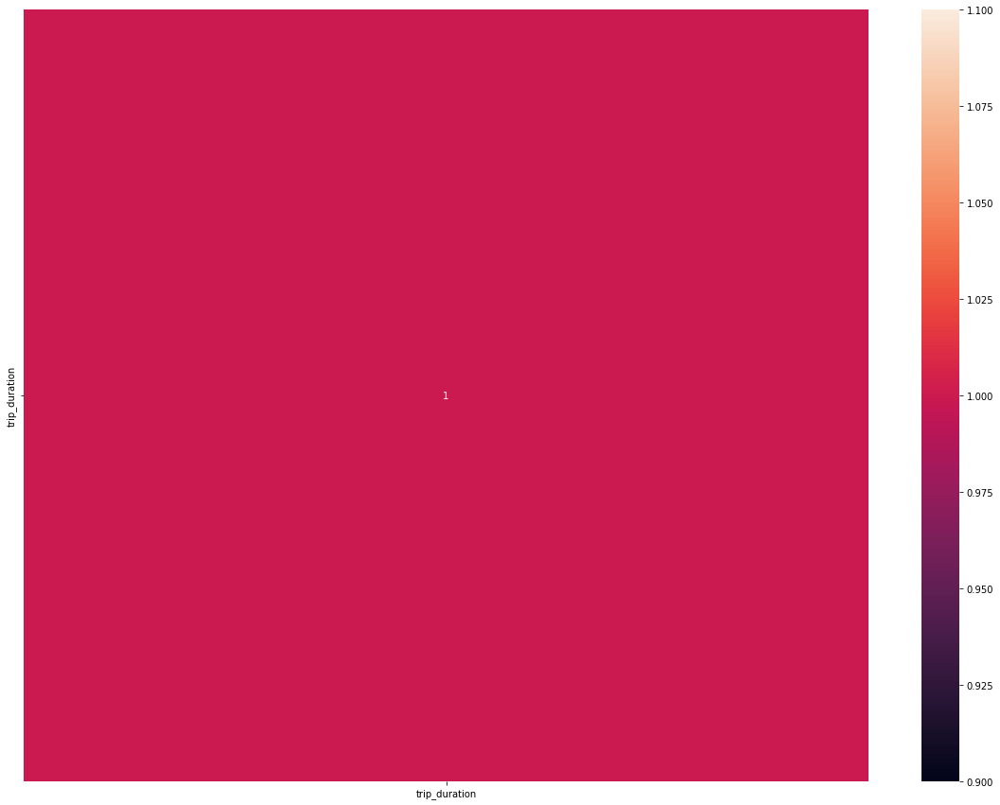

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

corr = etr_para_submissao.corr(method='pearson')

plt.figure(figsize=(20, 15))
sns.heatmap(corr, annot=True)
plt.show()

## Simplificações do modelo criado:

Para nosso modelo, desconsideramos:
*   Feriados
*   Horário de verão
*   O tempo em outros lugares fo ra de NY
*   A diferença de clima entre as microestações - tiramos uma média e atribuímos a informação ao dia. Consideramos que um ponto maior de neve ou precipitação pode impactar lugares onde isso não ocorre, por isso optamos pela média.

Adicionalmente, é preciso considerar a reduzida capacidade computacional para criação de modelos mais refinados e robustos; assim, diversos parâmetros precisaram ser ajustados à referida capacidade.

